## Step 2 Introduction
This is where the magic happens!  This notebook predicts the price of an item based on input image with the following steps:

1.) The csv we created in the EDA data extraction notebook is imported as a csv.  

2.) We set up our tensorflow CNN model and define a function to extract image embeddings with the model using predict().  Many models use the embeddings to tag or annotate images, we strip this part and just use the feature vectors / embedding extraction.  This is essentially our training data or data to compare a new image to identify what it is.

3.) We add the image embeddings back to the dataframe for the corresponding image (that in turn also represents a product/item).  

4.) We extract the image embedding from a new original image

5.) We calculate the cosine distance from the embeddings of the images in our dataframe to our original image embedding and then output a list of most similar images in descending order (with the lowest cosine distance first).

6.) We run multiple linear regression on the corresponding dataframe data and run a gridsearch to optimize the model to accurately predict the price of our item.

NOTE: I had a problem getting the correct data due to an api issue anmd expect to have MUCH more next week for my final submission.  I also expect to train and optimize my vision model by then too.  I am also looking into item segmentation to extract the background to better identify items, this should not affect this test as much as the items are already fairly well cropped.  Finally for large amounts of data I expect to save the embeddings to a vector db like pinecone or google vector search for performance.

In [1]:
import tensorflow as tf
import tensorflow_hub as hub
from tensorflow.keras import models, layers
from PIL import Image
import numpy as np
import pandas as pd

In [2]:
#import our dataset with images
df = pd.read_csv('scraping/EBAY_vinyl-records_2024-05-10-.csv')
df.head(5)

,ebay_id,title,location,condition,artist,release_year,image_url,sleeve_grading,record_grading,sold_date,sold,shipping_cost,image_file
0,4.049467e+11,Vtg Fleetwood Mac - Rumours Vinyl Record LP & ...,"Located in: Henderson, North Carolina, United ...",Used: An item that has been used previously. S...,Fleetwood Mac,1977,https://i.ebayimg.com/images/g/8KoAAOSwEFpmLZ5...,NaN,NaN,NaN,19.90,4.87,8KoAAOSwEFpmLZ53_s-l500.webp
1,2.261252e+11,Fleetwood Mac - Rumours - 1977 - Warner Bros B...,"Located in: Keyport, New Jersey, United States",Used: An item that has been used previously. S...,"Fleetwood Mac, Lindsey Buckingham, Stevie Nicks",1977,https://i.ebayimg.com/images/g/u0cAAOSwGdJmM89...,Good Plus (G+),Very Good Plus (VG+),NaN,13.50,4.85,u0cAAOSwGdJmM89m_s-l500.webp
2,3.951387e+11,Barry White Vinyl Record Lot - Can't Get Enoug...,"Located in: Merrimack, New Hampshire, United S...",UsedAn item that has been used previously. See...,"BEATLES, Barry White",NaN,https://i.ebayimg.com/images/g/rVIAAOSwE1NlptS...,NaN,NaN,NaN,49.99,NaN,rVIAAOSwE1NlptSv_s-l500.webp
3,1.667386e+11,FLEETWOOD MAC - Rumours - Vinyl L.P Warner Bro...,"Located in: Saint Louis, Missouri, United States",Used: An item that has been used previously. S...,Fleetwood Mac,1977,https://i.ebayimg.com/images/g/zK0AAOSwEFpmJj0...,Very Good (VG),Good Plus (G+),"May 06, 2024 16:11:12 PDT",16.00,5.50,zK0AAOSwEFpmJj0Q_s-l500.webp
4,2.047300e+11,CREAM ERIC CLAPTON LP VINYL LOT ORIGINAL LAYLA...,"Located in: Patchogue, New York, United States",Used: An item that has been used previously. S...,"Cream, Eric Clapton, Derek and the Dominos",NaN,https://i.ebayimg.com/images/g/KSYAAOSwmb1mEZZ...,Very Good Plus (VG+),Excellent (EX),"Apr 11, 2024 17:02:23 PDT",41.00,5.61,KSYAAOSwmb1mEZZh_s-l1600.webp


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 410 entries, 0 to 409
Data columns (total 13 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   ebay_id         410 non-null    float64
 1   title           410 non-null    object 
 2   location        410 non-null    object 
 3   condition       408 non-null    object 
 4   artist          407 non-null    object 
 5   release_year    230 non-null    object 
 6   image_url       410 non-null    object 
 7   sleeve_grading  285 non-null    object 
 8   record_grading  291 non-null    object 
 9   sold_date       168 non-null    object 
 10  sold            410 non-null    float64
 11  shipping_cost   391 non-null    float64
 12  image_file      410 non-null    object 
dtypes: float64(3), object(10)
memory usage: 41.8+ KB


In [15]:
#get model and set image size -> this was broken due to Keras versions see https://github.com/tensorflow/tensorflow/issues/63849
# pre trained model -> https://www.kaggle.com/models/tensorflow/efficientnet/tensorFlow1/lite0-feature-vector/2
model_url = 'https://www.kaggle.com/models/tensorflow/efficientnet/TensorFlow2/b0-feature-vector/1'
#model_url = "https://www.kaggle.com/models/tensorflow/efficientnet/TensorFlow1/lite0-feature-vector/2"

IMAGE_SHAPE = (224, 224)

layer = hub.KerasLayer(model_url)
model = tf.keras.Sequential([layer])

#model = models.Sequential([
#    layers.Flatten(),
#    layers.Dense(128, activation=tf.nn.relu),
#    layers.Dense(10, activation=tf.nn.softmax)
#])

#model.compile(optimizer=tf.keras.optimizers.Adam(), loss='sparse_categorical_crossentropy')

2024-05-13 18:46:28.090502: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'inputs' with dtype int32 and shape [4]
	 [[{{node inputs}}]]
2024-05-13 18:46:28.090747: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'inputs' with dtype int32 and shape [4]
	 [[{{node inputs}}]]
2024-05-13 18:46:28.130711: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'inputs' with dtype int32 and shape [4]
	 [[{{node inputs}}]]
2024-05-13 18:46:28.130751: 

In [16]:
#created a function to extract the embedding using the model, hide print if we have a lot of images
def extract(file):
  file = Image.open(file).convert('L').resize(IMAGE_SHAPE)
  display(file)

  file = np.stack((file,)*3, axis=-1)

  file = np.array(file)/255.0

  embedding = model.predict(file[np.newaxis, ...])
  #print(embedding)
  vgg16_feature_np = np.array(embedding)
  flattended_feature = vgg16_feature_np.flatten()

#  print(len(flattended_feature))
#  print(flattended_feature)
#  print('-----------')
  return flattended_feature

extracting image: 8KoAAOSwEFpmLZ53_s-l500.webp


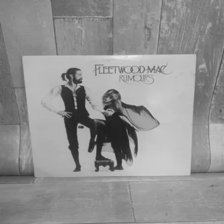

2024-05-13 18:46:47.733689: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'inputs' with dtype float and shape [?,224,224,3]
	 [[{{node inputs}}]]
2024-05-13 18:46:47.824099: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder' with dtype float and shape [?,224,224,3]
	 [[{{node Placeholder}}]]


1/1 [==============================] - 1s 543ms/step
extracting image: u0cAAOSwGdJmM89m_s-l500.webp


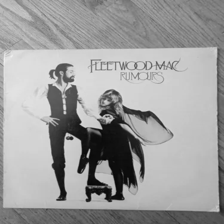

1/1 [==============================] - 0s 29ms/step
extracting image: rVIAAOSwE1NlptSv_s-l500.webp


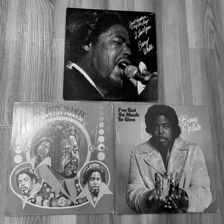

1/1 [==============================] - 0s 28ms/step
extracting image: zK0AAOSwEFpmJj0Q_s-l500.webp


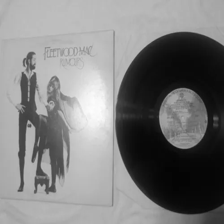

1/1 [==============================] - 0s 29ms/step
extracting image: KSYAAOSwmb1mEZZh_s-l1600.webp


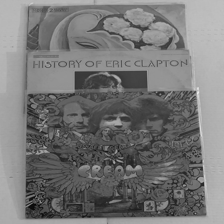

1/1 [==============================] - 0s 29ms/step
extracting image: 5ocAAOSwilxmMV~O_s-l1600.webp


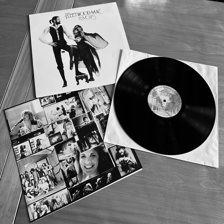

1/1 [==============================] - 0s 30ms/step
extracting image: czIAAOSwC2xlDQ1-_s-l500.webp


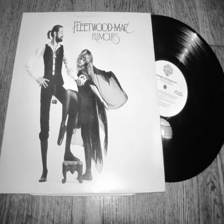

1/1 [==============================] - 0s 30ms/step
extracting image: xO0AAOSwQA9mGDCo_s-l1600.webp


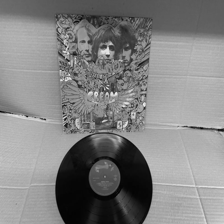

1/1 [==============================] - 0s 30ms/step
extracting image: NQ4AAOSwWp5mO35B_s-l500.webp


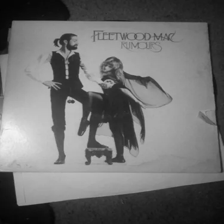

1/1 [==============================] - 0s 29ms/step
extracting image: 7XMAAOSwZRtmMMZs_s-l1600.webp


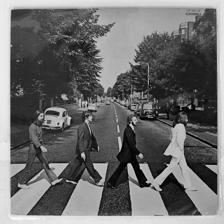

1/1 [==============================] - 0s 29ms/step
extracting image: 7bgAAOSw209luw2R_s-l1600.webp


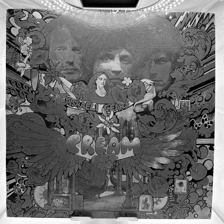

1/1 [==============================] - 0s 28ms/step
extracting image: itgAAOSwq5Fl7gkb_s-l1600.webp


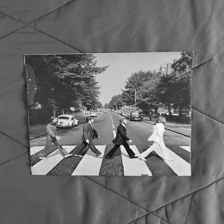

1/1 [==============================] - 0s 27ms/step
extracting image: xX4AAOSwih9mCNah_s-l1600.webp


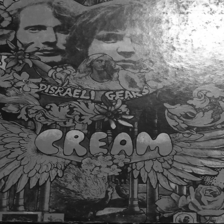

1/1 [==============================] - 0s 26ms/step
extracting image: uOgAAOSwsStmFK-u_s-l1600.webp


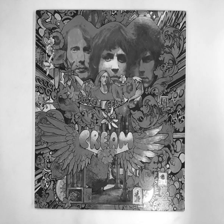

1/1 [==============================] - 0s 27ms/step
extracting image: V1MAAOSwkSZl8biO_s-l500.webp


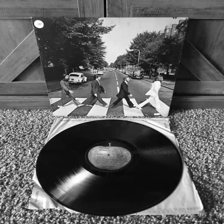

1/1 [==============================] - 0s 26ms/step
extracting image: s7oAAOSwu5dmMaEM_s-l500.webp


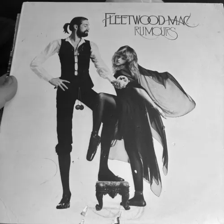

1/1 [==============================] - 0s 27ms/step
extracting image: nFkAAOSwHUtmGbOU_s-l1600.webp


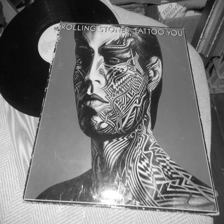

1/1 [==============================] - 0s 27ms/step
extracting image: m9IAAOSwJkVmPNGB_s-l1600.webp


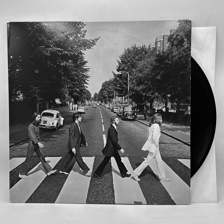

1/1 [==============================] - 0s 31ms/step
extracting image: ~2wAAOSwKGxmKpuE_s-l1600.webp


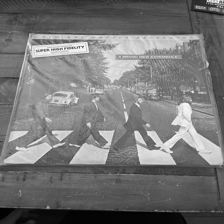

1/1 [==============================] - 0s 28ms/step
extracting image: 8PUAAOSwzNBmAbM3_s-l1600.jpg


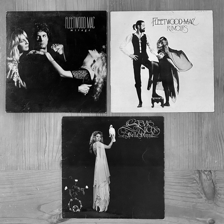

1/1 [==============================] - 0s 30ms/step
extracting image: p-wAAOSw82tmLB9H_s-l500.webp


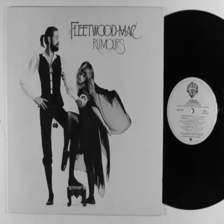

1/1 [==============================] - 0s 29ms/step
extracting image: m9AAAOSwztBmEout_s-l1600.webp


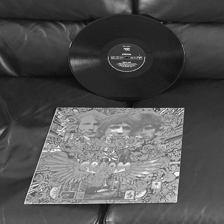

1/1 [==============================] - 0s 28ms/step
extracting image: yx0AAOSwH6lmOTjB_s-l1600.webp


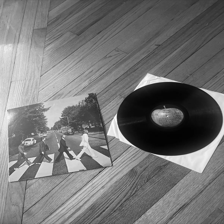

1/1 [==============================] - 0s 29ms/step
extracting image: Z0IAAOSwKK1mN8UT_s-l1600.webp


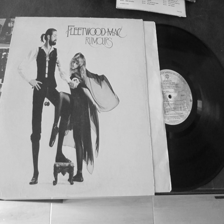

1/1 [==============================] - 0s 30ms/step
extracting image: QG0AAOSwFEVmL89i_s-l500.webp


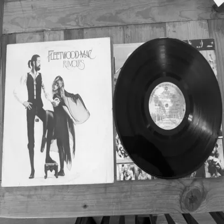

1/1 [==============================] - 0s 33ms/step
extracting image: 7pMAAOSwyONmMMZc_s-l300.webp


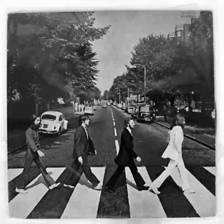

1/1 [==============================] - 0s 31ms/step
extracting image: xhwAAOSwmZpmM7Uz_s-l1600.webp


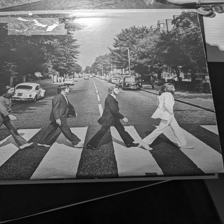

1/1 [==============================] - 0s 30ms/step
extracting image: 0nQAAOSwOjFmNBIF_s-l1600.webp


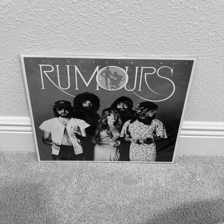

1/1 [==============================] - 0s 30ms/step
extracting image: -JkAAOSwHzlmFGVL_s-l1600.webp


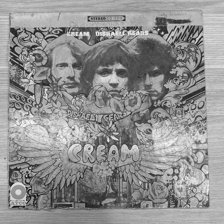

1/1 [==============================] - 0s 31ms/step
extracting image: jjYAAOSw3aVmLWlJ_s-l500.webp


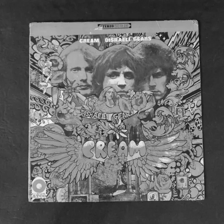

1/1 [==============================] - 0s 29ms/step
extracting image: K4sAAOSw3eJmJ3y7_s-l1600.webp


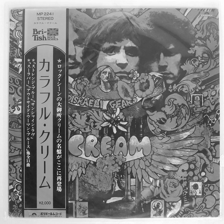

1/1 [==============================] - 0s 31ms/step
extracting image: uh0AAOSwhOdmIsol_s-l500.webp


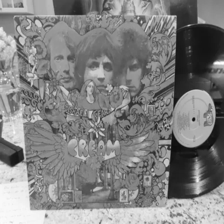

1/1 [==============================] - 0s 31ms/step
extracting image: pjYAAOSwwdRmKXEB_s-l500.webp


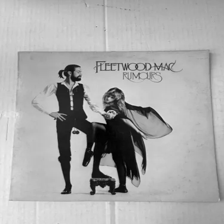

1/1 [==============================] - 0s 32ms/step
extracting image: c8MAAOSwZh9lCNXW_s-l500.webp


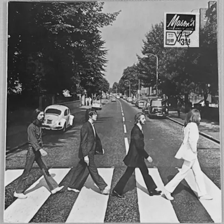

1/1 [==============================] - 0s 31ms/step
extracting image: UxsAAOSwe4FmHGDW_s-l1600.webp


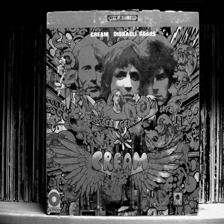

1/1 [==============================] - 0s 33ms/step
extracting image: pOMAAOSwkAll-~Xw_s-l1600.webp


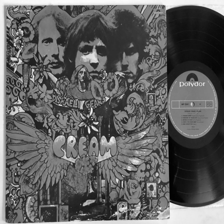

1/1 [==============================] - 0s 31ms/step
extracting image: LqoAAOSwbbFmMufb_s-l1600.webp


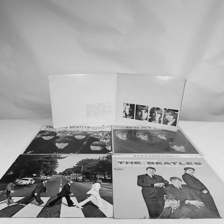

1/1 [==============================] - 0s 30ms/step
extracting image: n~8AAOSwFzlmL8Qb_s-l1600.webp


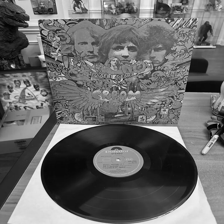

1/1 [==============================] - 0s 31ms/step
extracting image: se0AAOSwNuVmPAbf_s-l500.webp


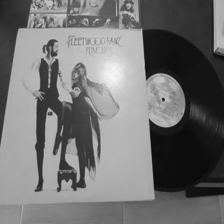

1/1 [==============================] - 0s 32ms/step
extracting image: jtUAAOSwd9dmAdub_s-l500.webp


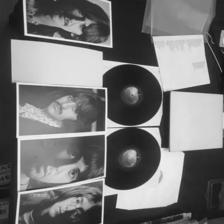

1/1 [==============================] - 0s 33ms/step
extracting image: oZEAAOSwhMxmNjMt_s-l1600.webp


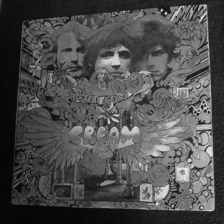

1/1 [==============================] - 0s 31ms/step
extracting image: fU0AAOSwjKhmNjNj_s-l300.webp


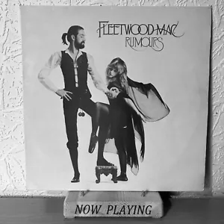

1/1 [==============================] - 0s 30ms/step
extracting image: O~wAAOSw42VmM6pJ_s-l500.webp


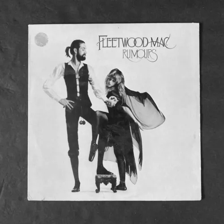

1/1 [==============================] - 0s 29ms/step
extracting image: LkUAAOSwmXZmIS4T_s-l500.webp


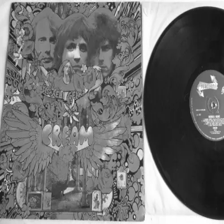

1/1 [==============================] - 0s 29ms/step
extracting image: rdYAAOSwr6RmPRSH_s-l1600.webp


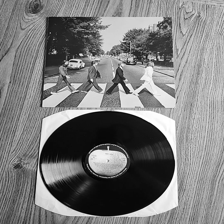

1/1 [==============================] - 0s 27ms/step
extracting image: kEQAAOSw~8JmLo9m_s-l500.webp


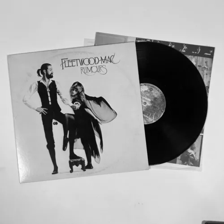

1/1 [==============================] - 0s 29ms/step
extracting image: 5FcAAOSwi5NmITql_s-l1600.webp


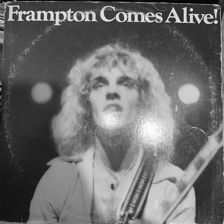

1/1 [==============================] - 0s 28ms/step
extracting image: sk0AAOSwFPNmL4zD_s-l1600.webp


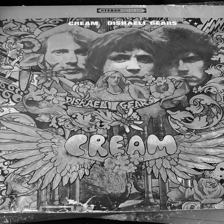

1/1 [==============================] - 0s 29ms/step
extracting image: mRMAAOSwG0VmMa9I_s-l1600.webp


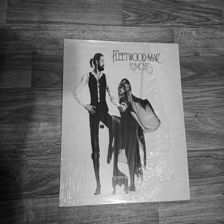

1/1 [==============================] - 0s 29ms/step
extracting image: ZaUAAOSw8Y1mNnjI_s-l1600.webp


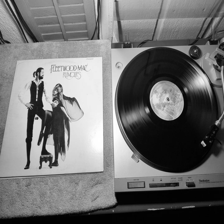

1/1 [==============================] - 0s 27ms/step
extracting image: b1gAAOSwfOpmGzzj_s-l1600.webp


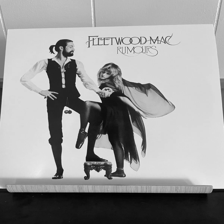

1/1 [==============================] - 0s 28ms/step
extracting image: PoYAAOSw5WxmO-Uh_s-l500.webp


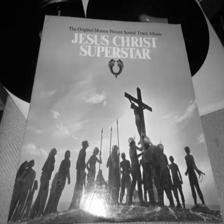

1/1 [==============================] - 0s 27ms/step
extracting image: 0D8AAOSwCnVl3mjO_s-l500.webp


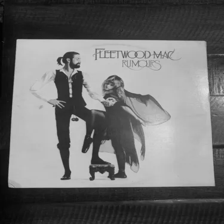

1/1 [==============================] - 0s 27ms/step
extracting image: 7n0AAOSw73RmN3Oy_s-l1600.webp


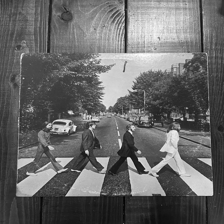

1/1 [==============================] - 0s 30ms/step
extracting image: 2YoAAOSwPmVmNHch_s-l1600.webp


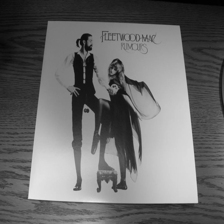

1/1 [==============================] - 0s 31ms/step
extracting image: 5SkAAOSwoFRl61iW_s-l500.webp


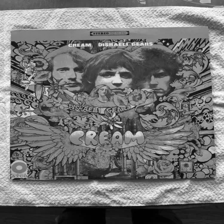

1/1 [==============================] - 0s 30ms/step
extracting image: 2qYAAOSwHiRmOlp-_s-l500.webp


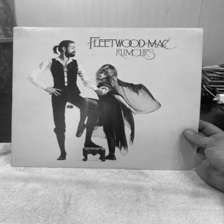

1/1 [==============================] - 0s 32ms/step
extracting image: -VUAAOSwtrhmO-X6_s-l1600.webp


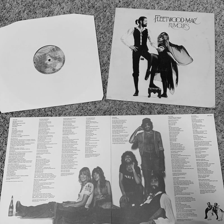

1/1 [==============================] - 0s 30ms/step
extracting image: MEYAAOSw3epmBGSq_s-l1600.webp


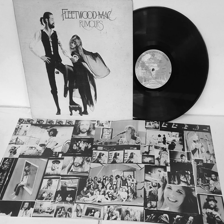

1/1 [==============================] - 0s 31ms/step
extracting image: slMAAOSwp3VmOBx6_s-l500.webp


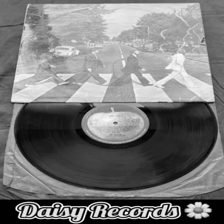

1/1 [==============================] - 0s 31ms/step
extracting image: Vq8AAOSw9~VmO-sp_s-l500.webp


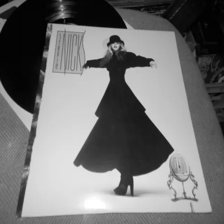

1/1 [==============================] - 0s 29ms/step
extracting image: lIkAAOSw3pdmGWtL_s-l1600.webp


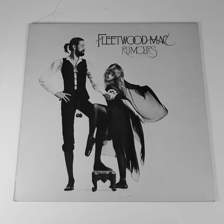

1/1 [==============================] - 0s 31ms/step
extracting image: qHIAAOSwWX9jvDT-_s-l1600.webp


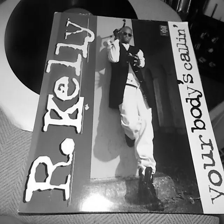

1/1 [==============================] - 0s 29ms/step
extracting image: z88AAOSwdwpmHlcu_s-l500.webp


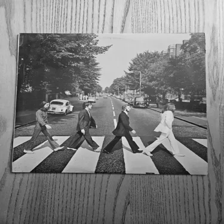

1/1 [==============================] - 0s 29ms/step
extracting image: 8NEAAOSwlJ5mCzAG_s-l1600.webp


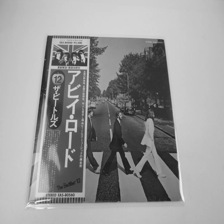

1/1 [==============================] - 0s 29ms/step
extracting image: mjkAAOSwf39mB7St_s-l1600.webp


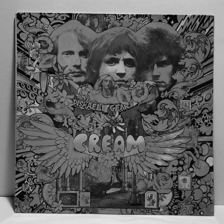

1/1 [==============================] - 0s 29ms/step
extracting image: WVYAAOSwJ~dihkue_s-l500.webp


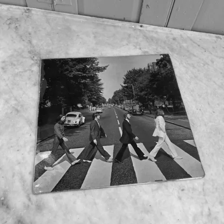

1/1 [==============================] - 0s 29ms/step
extracting image: TW0AAOSwaTpmLSrT_s-l1600.webp


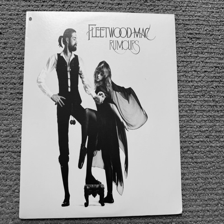

1/1 [==============================] - 0s 29ms/step
extracting image: MVIAAOSwiLBmByLM_s-l500.webp


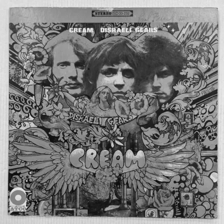

1/1 [==============================] - 0s 27ms/step
extracting image: wfIAAOSwW~lmJkaq_s-l1600.webp


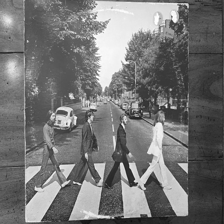

1/1 [==============================] - 0s 27ms/step
extracting image: UR0AAOSwjw9l39oa_s-l1600.webp


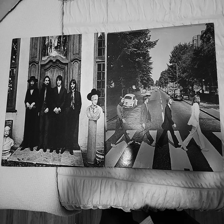

1/1 [==============================] - 0s 28ms/step
extracting image: OH0AAOSwMEZmMpP9_s-l500.webp


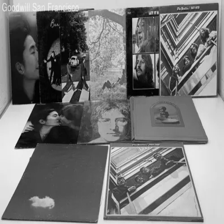

1/1 [==============================] - 0s 28ms/step
extracting image: 3PMAAOSwtedmMMX2_s-l500.webp


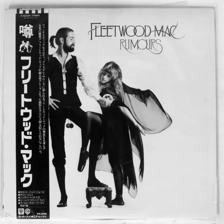

1/1 [==============================] - 0s 28ms/step
extracting image: jeEAAOSwXnVmM1aX_s-l1600.webp


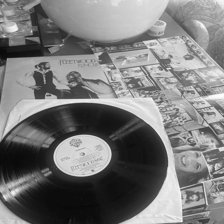

1/1 [==============================] - 0s 28ms/step
extracting image: Nv8AAOSwnqtmNuCn_s-l500.webp


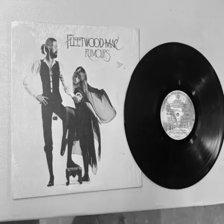

1/1 [==============================] - 0s 28ms/step
extracting image: zwwAAOSwxlJmNnzQ_s-l1600.webp


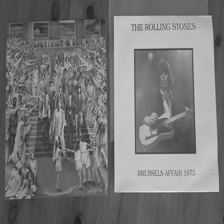

1/1 [==============================] - 0s 28ms/step
extracting image: lVQAAOSw~49kWXym_s-l300.webp


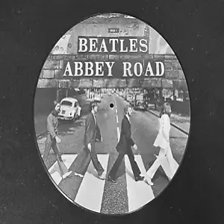

1/1 [==============================] - 0s 28ms/step
extracting image: 0wgAAOSwi-tmNA2M_s-l1600.webp


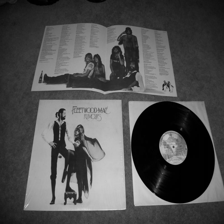

1/1 [==============================] - 0s 28ms/step
extracting image: QigAAOSwEXpmMY8i_s-l1600.webp


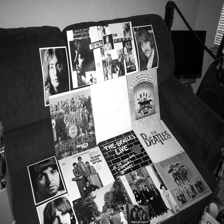

1/1 [==============================] - 0s 29ms/step
extracting image: 7QcAAOSw05dk28E3_s-l500.webp


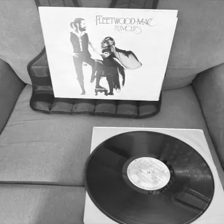

1/1 [==============================] - 0s 29ms/step
extracting image: F0MAAOSw82RmOQFx_s-l1600.webp


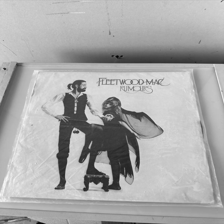

1/1 [==============================] - 0s 27ms/step
extracting image: t4kAAOSw6itlzLwN_s-l1600.webp


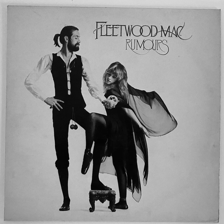

1/1 [==============================] - 0s 28ms/step
extracting image: FRoAAOSwYp1mMMa8_s-l500.jpg


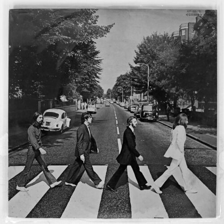

1/1 [==============================] - 0s 31ms/step
extracting image: gMAAAOSwj9llSpwP_s-l1600.webp


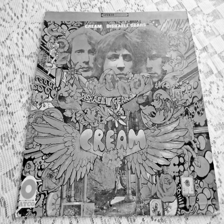

1/1 [==============================] - 0s 31ms/step
extracting image: OYQAAOSwduRmBq~t_s-l500.webp


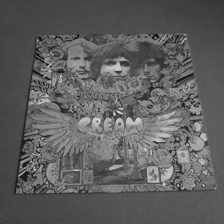

1/1 [==============================] - 0s 29ms/step
extracting image: -AwAAOSwFJZl1HgL_s-l1600.webp


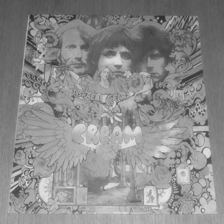

1/1 [==============================] - 0s 30ms/step
extracting image: cg0AAOSwZN5laq-C_s-l1600.webp


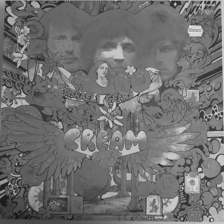

1/1 [==============================] - 0s 30ms/step
extracting image: 3ooAAOSwfHVkVsZl_s-l1600.webp


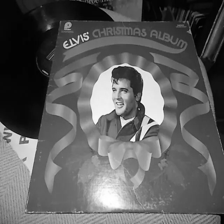

1/1 [==============================] - 0s 29ms/step
extracting image: DBwAAOSwZjtmNYQg_s-l500.webp


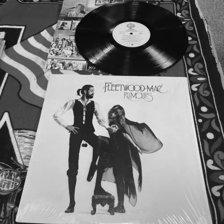

1/1 [==============================] - 0s 30ms/step
extracting image: Fg0AAOSwJ11mO1ot_s-l500.webp


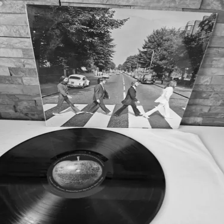

1/1 [==============================] - 0s 29ms/step
extracting image: cRkAAOSwILJmKj28_s-l500.webp


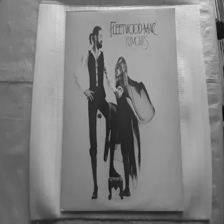

1/1 [==============================] - 0s 30ms/step
extracting image: DsYAAOSwL~NmJDWR_s-l1600.webp


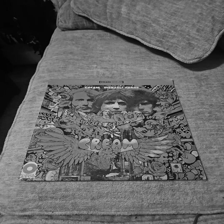

1/1 [==============================] - 0s 32ms/step
extracting image: E1gAAOSww6dmMkAF_s-l1600.webp


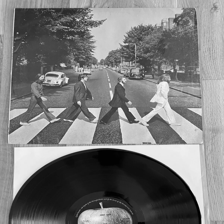

1/1 [==============================] - 0s 30ms/step
extracting image: diEAAOSwk3RmDZBc_s-l1600.webp


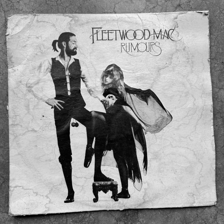

1/1 [==============================] - 0s 31ms/step
extracting image: wCcAAOSwkbZleJ9E_s-l1600.webp


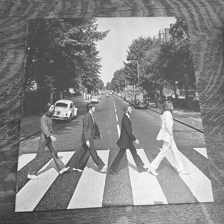

1/1 [==============================] - 0s 31ms/step
extracting image: 6G4AAOSw29pmLSqx_s-l1600.webp


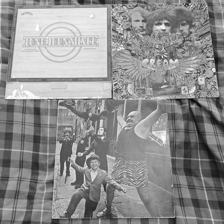

1/1 [==============================] - 0s 29ms/step
extracting image: i50AAOSw0phmHJow_s-l1600.webp


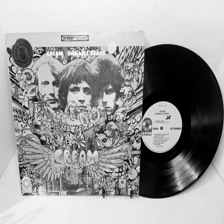

1/1 [==============================] - 0s 28ms/step
extracting image: lJsAAOSw~eBlwmLu_s-l1600.webp


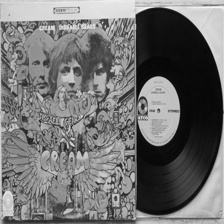

1/1 [==============================] - 0s 26ms/step
extracting image: gXcAAOSw3pdmEGnR_s-l1600.webp


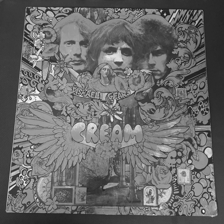

1/1 [==============================] - 0s 28ms/step
extracting image: 3gwAAOSw0vNmOxcs_s-l1600.webp


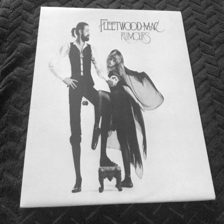

1/1 [==============================] - 0s 28ms/step
extracting image: TLsAAOSwBSpmDMOk_s-l1600.webp


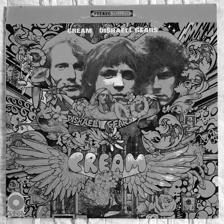

1/1 [==============================] - 0s 28ms/step
extracting image: e1UAAOSwvcBmBsSt_s-l1600.webp


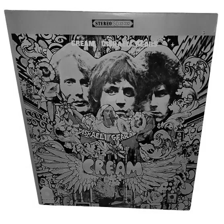

1/1 [==============================] - 0s 27ms/step
extracting image: 4a0AAOSwkrJmNOt8_s-l500.webp


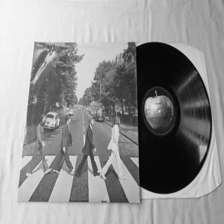

1/1 [==============================] - 0s 29ms/step
extracting image: hAoAAOSwmZ1mK4Yn_s-l500.webp


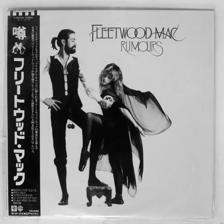

1/1 [==============================] - 0s 28ms/step
extracting image: qoQAAOSwxCFl8MyH_s-l1600.webp


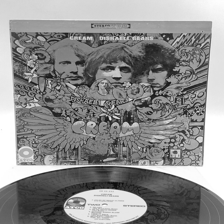

1/1 [==============================] - 0s 27ms/step
extracting image: rwkAAOSwVstmAJsE_s-l1600.webp


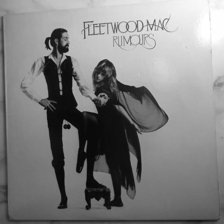

1/1 [==============================] - 0s 27ms/step
extracting image: ZvMAAOSwZPVl9gs9_s-l500.webp


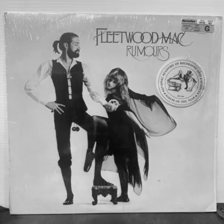

1/1 [==============================] - 0s 28ms/step
extracting image: -JkAAOSwHzlmFGVL_s-l1600.webp


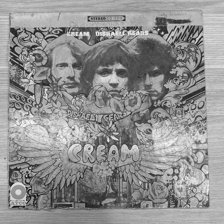

1/1 [==============================] - 0s 29ms/step
extracting image: RfYAAOSw~EtlSh7b_s-l500.webp


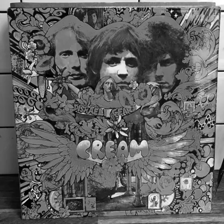

1/1 [==============================] - 0s 28ms/step
extracting image: 8IsAAOSwbxZlgQLR_s-l1600.webp


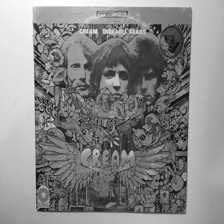

1/1 [==============================] - 0s 28ms/step
extracting image: ebYAAOSwNqZmGDp5_s-l500.webp


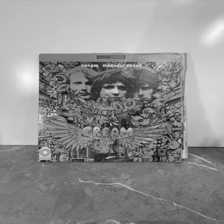

1/1 [==============================] - 0s 30ms/step
extracting image: 9lEAAOSwgKtmG97z_s-l500.webp


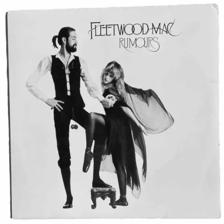

1/1 [==============================] - 0s 31ms/step
extracting image: nAQAAOSwgotmLmvm_s-l500.webp


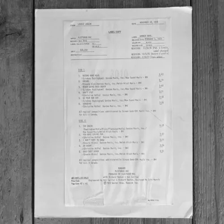

1/1 [==============================] - 0s 32ms/step
extracting image: 8J8AAOSwbI9mPIk7_s-l1600.webp


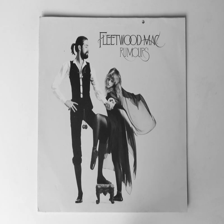

1/1 [==============================] - 0s 30ms/step
extracting image: idQAAOSwSuRl~cwy_s-l500.webp


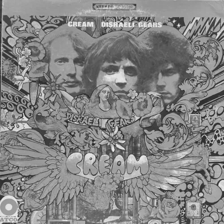

1/1 [==============================] - 0s 30ms/step
extracting image: CgMAAOSwhKlmOiQO_s-l500.webp


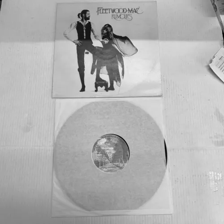

1/1 [==============================] - 0s 31ms/step
extracting image: MQYAAOSwQdFmCbsB_s-l500.webp


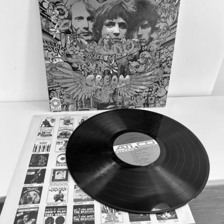

1/1 [==============================] - 0s 32ms/step
extracting image: jq8AAOSw25lmAS2K_s-l500.webp


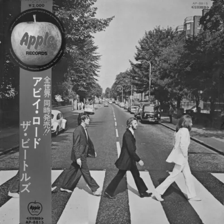

1/1 [==============================] - 0s 31ms/step
extracting image: ndIAAOSw0ZBmN2Qc_s-l500.webp


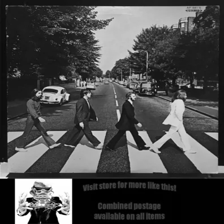

1/1 [==============================] - 0s 29ms/step
extracting image: 67QAAOSwMEZmMv3k_s-l1600.webp


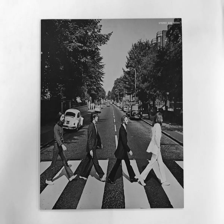

1/1 [==============================] - 0s 30ms/step
extracting image: l1cAAOSwB2ZmAfX3_s-l1600.webp


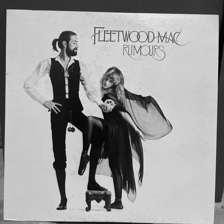

1/1 [==============================] - 0s 30ms/step
extracting image: 7AYAAOSwXCtkV67q_s-l500.webp


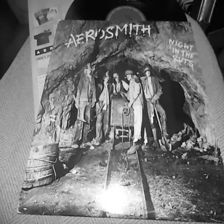

1/1 [==============================] - 0s 32ms/step
extracting image: FfMAAOSww~BmGRgl_s-l1600.webp


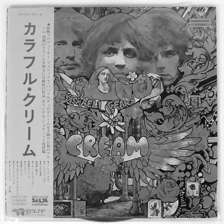

1/1 [==============================] - 0s 30ms/step
extracting image: -LcAAOSwiMxmMvsL_s-l1600.webp


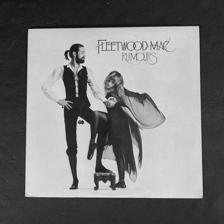

1/1 [==============================] - 0s 32ms/step
extracting image: GIUAAOSw2GtmFAxB_s-l1600.webp


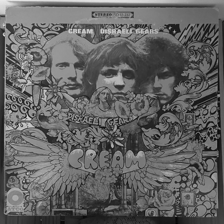

1/1 [==============================] - 0s 30ms/step
extracting image: pokAAOSwQVpmNlEc_s-l500.webp


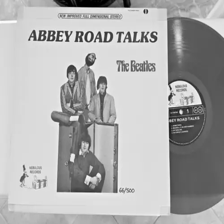

1/1 [==============================] - 0s 30ms/step
extracting image: yPkAAOSw4tJl1Ryg_s-l1600.webp


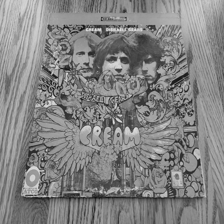

1/1 [==============================] - 0s 29ms/step
extracting image: 7PAAAOSwZRtmMMYe_s-l500.webp


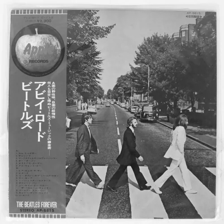

1/1 [==============================] - 0s 28ms/step
extracting image: SSMAAOSwqqBmM6SZ_s-l500.webp


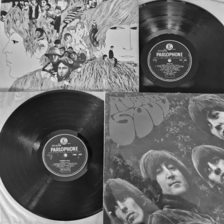

1/1 [==============================] - 0s 27ms/step
extracting image: JE8AAOSwYFljvyuw_s-l1600.webp


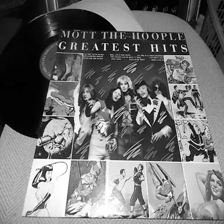

1/1 [==============================] - 0s 28ms/step
extracting image: oDcAAOSwZytlQpeM_s-l500.webp


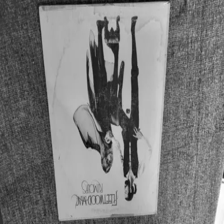

1/1 [==============================] - 0s 28ms/step
extracting image: lhsAAOSw8t5mMjCK_s-l1600.webp


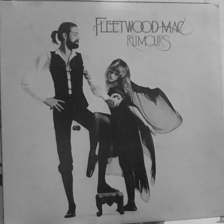

1/1 [==============================] - 0s 26ms/step
extracting image: YLsAAOSwFrRk723v_s-l500.webp


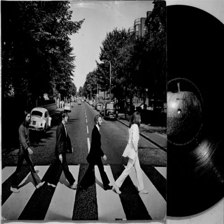

1/1 [==============================] - 0s 28ms/step
extracting image: ptkAAOSwJtNmGYch_s-l500.webp


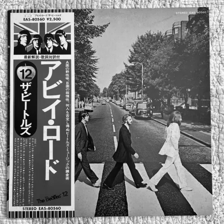

1/1 [==============================] - 0s 27ms/step
extracting image: r3oAAOSw8HxmCB0N_s-l500.webp


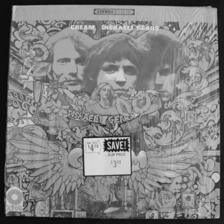

1/1 [==============================] - 0s 28ms/step
extracting image: FhIAAOSwQTVmMvqQ_s-l500.webp


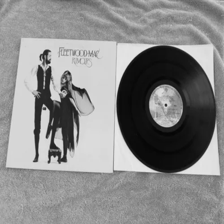

1/1 [==============================] - 0s 28ms/step
extracting image: rPkAAOSw-VRmLc0D_s-l1600.webp


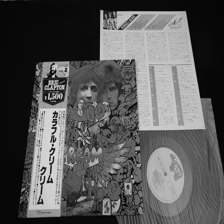

1/1 [==============================] - 0s 28ms/step
extracting image: jWsAAOSw-0pmMFgr_s-l500.webp


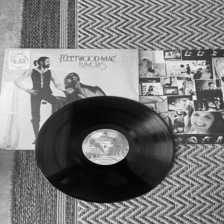

1/1 [==============================] - 0s 29ms/step
extracting image: eFAAAOSwSRJl8q1O_s-l500.webp


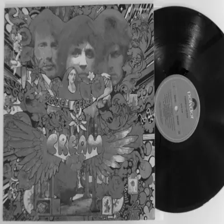

1/1 [==============================] - 0s 28ms/step
extracting image: eN0AAOSw1qJl~gGX_s-l1600.webp


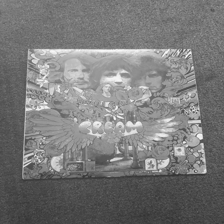

1/1 [==============================] - 0s 27ms/step
extracting image: 0n4AAOSwko5k0qd-_s-l1600.webp


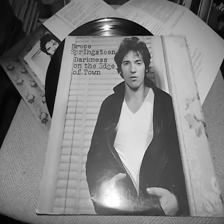

1/1 [==============================] - 0s 28ms/step
extracting image: EwYAAOSwQrZmBdAc_s-l1600.webp


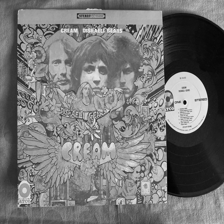

1/1 [==============================] - 0s 27ms/step
extracting image: 2mAAAOSwS1JmFujm_s-l1600.webp


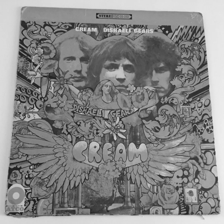

1/1 [==============================] - 0s 28ms/step
extracting image: josAAOSwgptl~qfj_s-l1600.webp


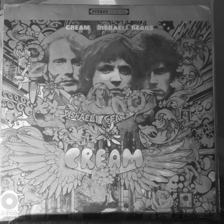

1/1 [==============================] - 0s 28ms/step
extracting image: K1oAAOSwkblmJJa3_s-l1600.webp


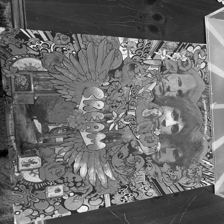

1/1 [==============================] - 0s 34ms/step
extracting image: 3x0AAOSw0BBmGbeR_s-l1600.webp


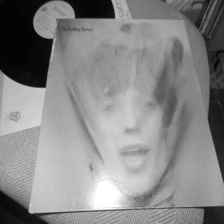

1/1 [==============================] - 0s 28ms/step
extracting image: BCYAAOSw0LdmKDdn_s-l500.webp


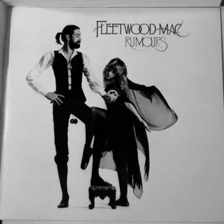

1/1 [==============================] - 0s 29ms/step
extracting image: ~zoAAOSw8KBmO9r0_s-l500.webp


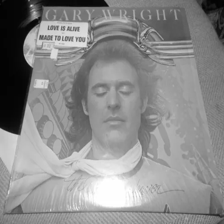

1/1 [==============================] - 0s 30ms/step
extracting image: YZUAAOSwM5FmMlT8_s-l1600.webp


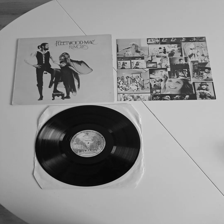

1/1 [==============================] - 0s 29ms/step
extracting image: M1gAAOSw-eJjEOu3_s-l1600.webp


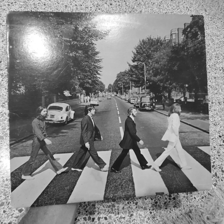

1/1 [==============================] - 0s 29ms/step
extracting image: Q3sAAOSwxGBmKC1R_s-l1600.webp


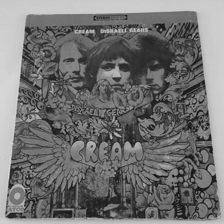

1/1 [==============================] - 0s 28ms/step
extracting image: 100AAOSw7ZFmOCMT_s-l500.webp


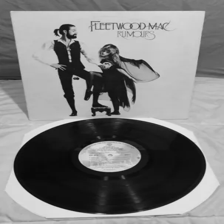

1/1 [==============================] - 0s 28ms/step
extracting image: oO8AAOSwiGJki53I_s-l1600.webp


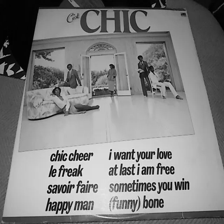

1/1 [==============================] - 0s 28ms/step
extracting image: C6sAAOSwrl9kC2n~_s-l1600.webp


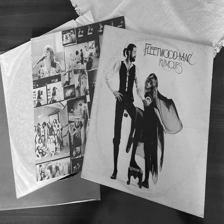

1/1 [==============================] - 0s 28ms/step
extracting image: tXgAAOSwMLNmNGM4_s-l1600.webp


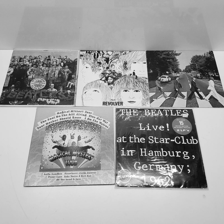

1/1 [==============================] - 0s 30ms/step
extracting image: WwIAAOSw7NxmMah8_s-l1600.webp


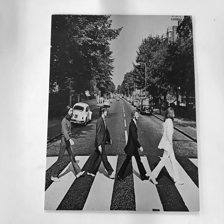

1/1 [==============================] - 0s 31ms/step
extracting image: uygAAOSwuY5mNoel_s-l500.webp


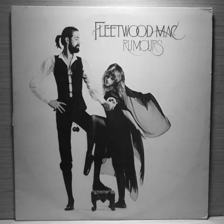

1/1 [==============================] - 0s 28ms/step
extracting image: LTEAAOSwy5Fkd1EH_s-l1600.webp


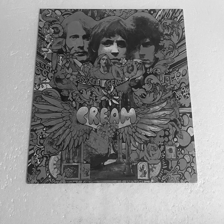

1/1 [==============================] - 0s 28ms/step
extracting image: jN4AAOSwog1khmCL_s-l500.webp


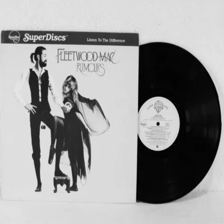

1/1 [==============================] - 0s 28ms/step
extracting image: ro0AAOSwlCFl81iX_s-l500.webp


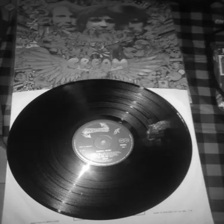

1/1 [==============================] - 0s 29ms/step
extracting image: 0pcAAOSwep1mK7l~_s-l1600.webp


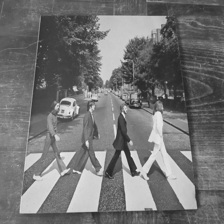

1/1 [==============================] - 0s 29ms/step
extracting image: LfoAAOSwnXhlhdY3_s-l500.webp


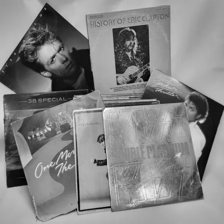

1/1 [==============================] - 0s 28ms/step
extracting image: K~UAAOSwnbZmNOJc_s-l1600.webp


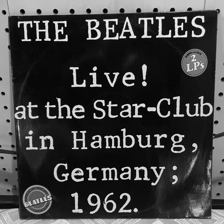

1/1 [==============================] - 0s 28ms/step
extracting image: 1DUAAOSwMWFmNAGy_s-l1600.webp


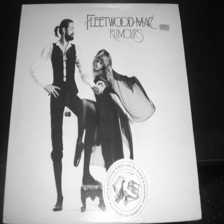

1/1 [==============================] - 0s 28ms/step
extracting image: pOMAAOSwkAll-~Xw_s-l1600.webp


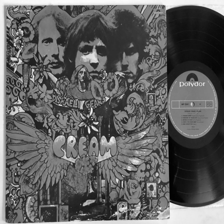

1/1 [==============================] - 0s 28ms/step
extracting image: 2rAAAOSwl9xmJ6bV_s-l1600.webp


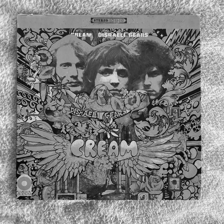

1/1 [==============================] - 0s 31ms/step
extracting image: lCgAAOSwa1ZmLmGw_s-l1600.webp


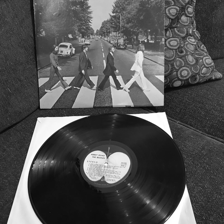

1/1 [==============================] - 0s 30ms/step
extracting image: g1MAAOSwMgJmNyGF_s-l1600.webp


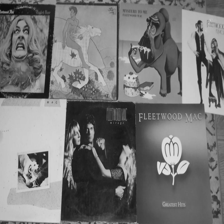

1/1 [==============================] - 0s 30ms/step
extracting image: shkAAOSwZadmIr9i_s-l1600.webp


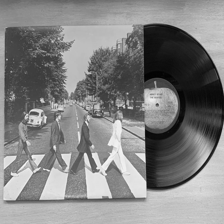

1/1 [==============================] - 0s 30ms/step
extracting image: -AIAAOSwqCpmMMXY_s-l1600.webp


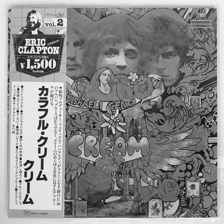

1/1 [==============================] - 0s 30ms/step
extracting image: Wx4AAOSw~LJi2ZYy_s-l1600.webp


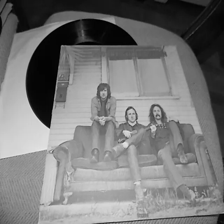

1/1 [==============================] - 0s 27ms/step
extracting image: TzoAAOSwn0pmOndD_s-l1600.webp


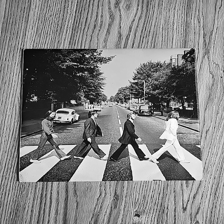

1/1 [==============================] - 0s 28ms/step
extracting image: zi0AAOSwa11lBlf9_s-l1600.webp


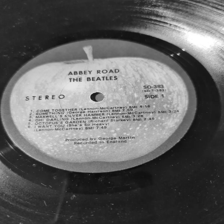

1/1 [==============================] - 0s 27ms/step
extracting image: PdwAAOSwBjBmD2MQ_s-l1600.webp


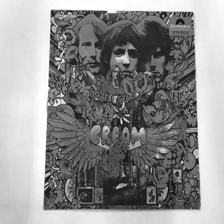

1/1 [==============================] - 0s 27ms/step
extracting image: fwgAAOSwVP5mHA5U_s-l300.webp


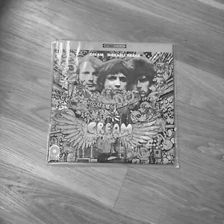

1/1 [==============================] - 0s 27ms/step
extracting image: K6EAAOSwRPBmN0-i_s-l500.webp


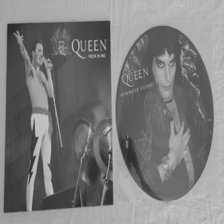

1/1 [==============================] - 0s 29ms/step
extracting image: Ek4AAOSw-dlmGSwJ_s-l1600.webp


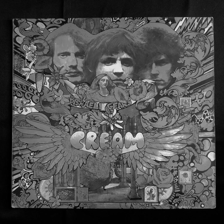

1/1 [==============================] - 0s 30ms/step
extracting image: fJ0AAOSwxxpiQtMI_s-l1600.webp


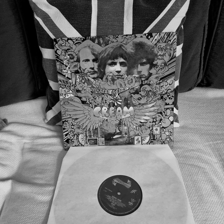

1/1 [==============================] - 0s 30ms/step
extracting image: fA8AAOSw5cVlxRrY_s-l500.webp


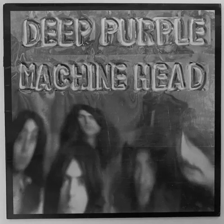

1/1 [==============================] - 0s 29ms/step
extracting image: ACUAAOSwebNlee0G_s-l500.webp


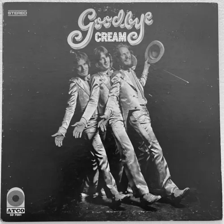

1/1 [==============================] - 0s 29ms/step
extracting image: 12EAAOSwn2Nl6ZnJ_s-l500.webp


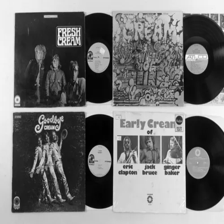

1/1 [==============================] - 0s 29ms/step
extracting image: 7zYAAOSwb65mH4Ky_s-l300.webp


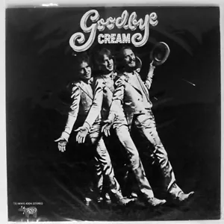

1/1 [==============================] - 0s 28ms/step
extracting image: YqcAAOSwtK9k02uS_s-l500.webp


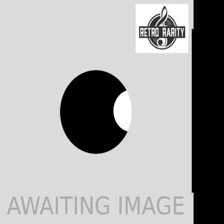

1/1 [==============================] - 0s 29ms/step
extracting image: CvEAAOSwyvlmGEYg_s-l1600.webp


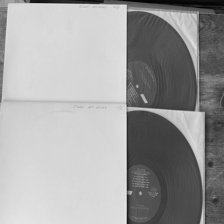

1/1 [==============================] - 0s 30ms/step
extracting image: N~cAAOSwhlBmFYtJ_s-l1600.webp


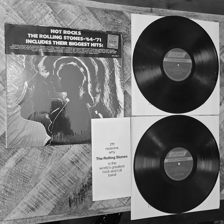

1/1 [==============================] - 0s 29ms/step
extracting image: GbwAAOSwPn5kfp8-_s-l500.webp


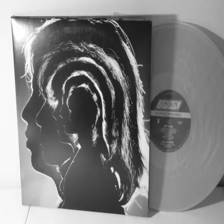

1/1 [==============================] - 0s 28ms/step
extracting image: xvUAAOSwjl9hyOMy_s-l1600.webp


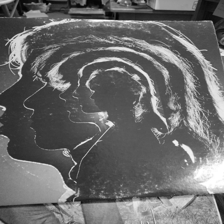

1/1 [==============================] - 0s 29ms/step
extracting image: BxcAAOSwKGxmKchZ_s-l1600.webp


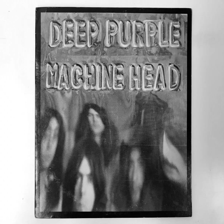

1/1 [==============================] - 0s 30ms/step
extracting image: i2wAAOSwYHZl1NUW_s-l1600.webp


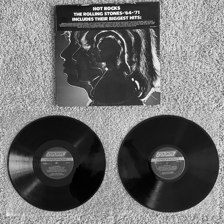

1/1 [==============================] - 0s 28ms/step
extracting image: lcQAAOSwxbdmGtQj_s-l500.webp


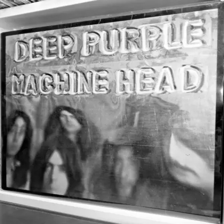

1/1 [==============================] - 0s 30ms/step
extracting image: JbQAAOSwpTdmMFtZ_s-l1600.webp


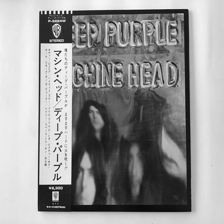

1/1 [==============================] - 0s 29ms/step
extracting image: KSMAAOSw1K5mNvAx_s-l1600.webp


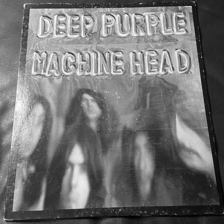

1/1 [==============================] - 0s 30ms/step
extracting image: T9EAAOSwJWRleJpj_s-l1600.webp


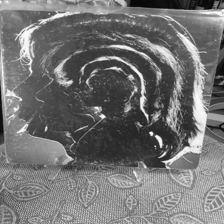

1/1 [==============================] - 0s 30ms/step
extracting image: 1igAAOSwoWBl4e~f_s-l1600.webp


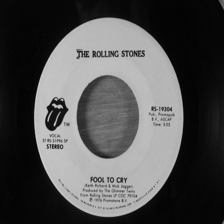

1/1 [==============================] - 0s 29ms/step
extracting image: 0m8AAOSwg4pmHTlC_s-l1600.webp


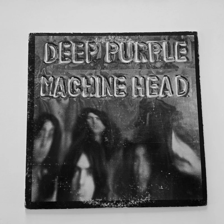

1/1 [==============================] - 0s 28ms/step
extracting image: x4EAAOSwiLJlStgr_s-l1600.webp


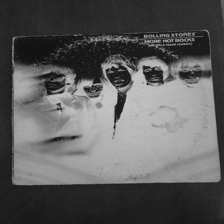

1/1 [==============================] - 0s 26ms/step
extracting image: 6WAAAOSwj5NmMA3W_s-l500.webp


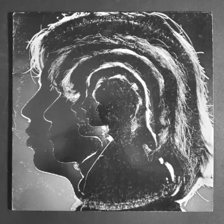

1/1 [==============================] - 0s 28ms/step
extracting image: jDwAAOSw0EVmLobv_s-l1600.webp


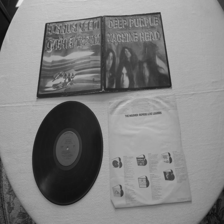

1/1 [==============================] - 0s 28ms/step
extracting image: 960AAOSwKCJmLhjW_s-l500.webp


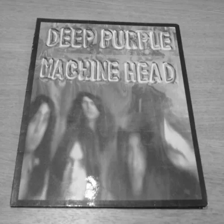

1/1 [==============================] - 0s 28ms/step
extracting image: kAQAAOSwkEhlO9u0_s-l1600.webp


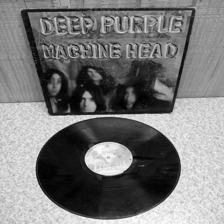

1/1 [==============================] - 0s 30ms/step
extracting image: QsgAAOSwG35mCdLO_s-l1600.webp


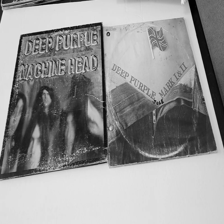

1/1 [==============================] - 0s 29ms/step
extracting image: in4AAOSwvDZlW-pk_s-l1600.webp


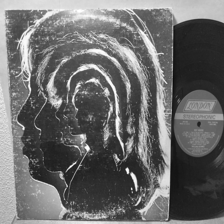

1/1 [==============================] - 0s 28ms/step
extracting image: thoAAOSw2l1mE39s_s-l1600.webp


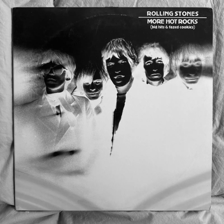

1/1 [==============================] - 0s 29ms/step
extracting image: 4voAAOSwL7xmIVMl_s-l1600.webp


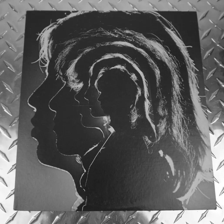

1/1 [==============================] - 0s 28ms/step
extracting image: RxkAAOSwJtllrqR3_s-l500.webp


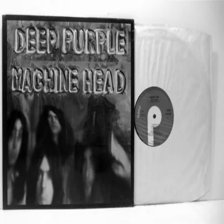

1/1 [==============================] - 0s 28ms/step
extracting image: JYoAAOSwUYBlPrR8_s-l1600.webp


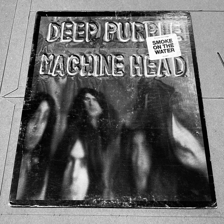

1/1 [==============================] - 0s 29ms/step
extracting image: z~cAAOSwrBtmLPaP_s-l1600.webp


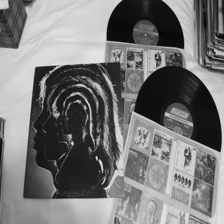

1/1 [==============================] - 0s 29ms/step
extracting image: YLgAAOSwWqhmEZ65_s-l1600.webp


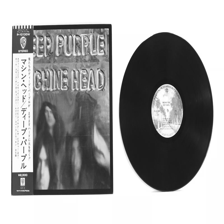

1/1 [==============================] - 0s 29ms/step
extracting image: UIAAAOSwDuZmCw-K_s-l500.webp


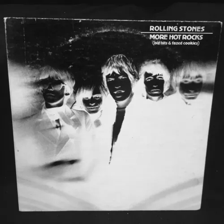

1/1 [==============================] - 0s 29ms/step
extracting image: asAAAOSwXidmHwMc_s-l500.webp


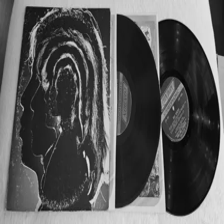

1/1 [==============================] - 0s 29ms/step
extracting image: cKIAAOSwSudmM3PA_s-l1600.webp


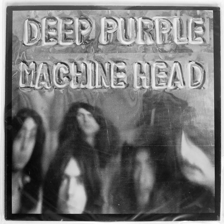

1/1 [==============================] - 0s 28ms/step
extracting image: zzcAAOSwy~ll79TN_s-l500.webp


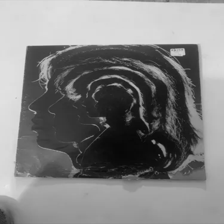

1/1 [==============================] - 0s 27ms/step
extracting image: S5kAAOSww3tmK4UP_s-l500.webp


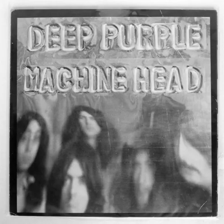

1/1 [==============================] - 0s 29ms/step
extracting image: dxIAAOSwLQtmFwPL_s-l500.webp


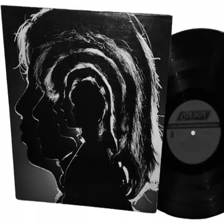

1/1 [==============================] - 0s 28ms/step
extracting image: ~JUAAOSwl~lmJkRD_s-l1600.webp


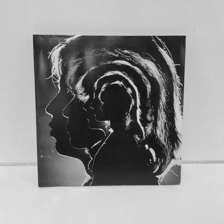

1/1 [==============================] - 0s 28ms/step
extracting image: FLoAAOSw6UZmLkya_s-l1600.webp


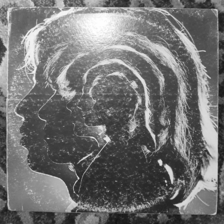

1/1 [==============================] - 0s 28ms/step
extracting image: quUAAOSwjilludrb_s-l1600.webp


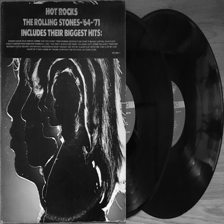

1/1 [==============================] - 0s 28ms/step
extracting image: Js0AAOSwauZiXhDi_s-l500.webp


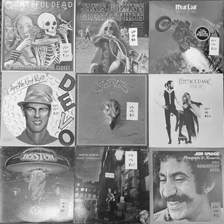

1/1 [==============================] - 0s 27ms/step
extracting image: IM8AAOSwanlmJWfr_s-l1600.webp


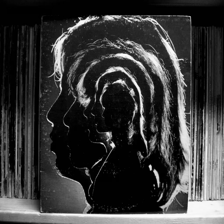

1/1 [==============================] - 0s 28ms/step
extracting image: ZmQAAOSwia9l~iUo_s-l1600.webp


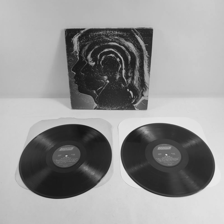

1/1 [==============================] - 0s 29ms/step
extracting image: kksAAOSwADNlwVQJ_s-l500.webp


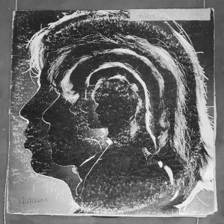

1/1 [==============================] - 0s 28ms/step
extracting image: ZTIAAOSwxp1mJ3yg_s-l1600.webp


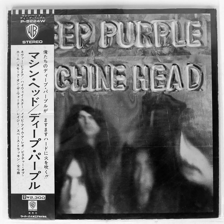

1/1 [==============================] - 0s 27ms/step
extracting image: FI0AAOSwY-VmFKdY_s-l1600.webp


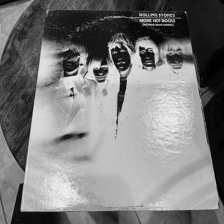

1/1 [==============================] - 0s 30ms/step
extracting image: 0BUAAOSwvftmHUiZ_s-l500.webp


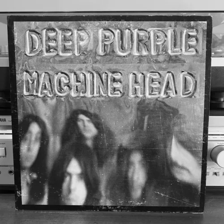

1/1 [==============================] - 0s 27ms/step
extracting image: MPkAAOSwpmxlSpp4_s-l500.webp


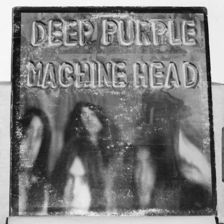

1/1 [==============================] - 0s 27ms/step
extracting image: q4EAAOSwVVZmLqj~_s-l500.webp


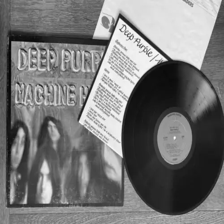

1/1 [==============================] - 0s 28ms/step
extracting image: -NsAAOSw519mIX0E_s-l1600.webp


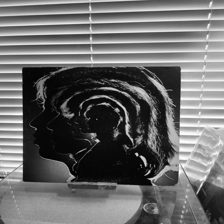

1/1 [==============================] - 0s 31ms/step
extracting image: 1eEAAOSwwIVmJoiF_s-l500.webp


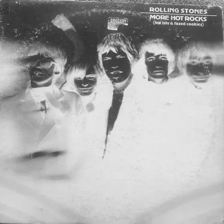

1/1 [==============================] - 0s 32ms/step
extracting image: 8HIAAOSwPWFl7jlR_s-l500.webp


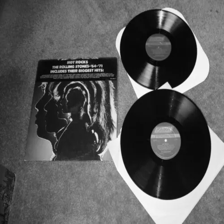

1/1 [==============================] - 0s 34ms/step
extracting image: 1PMAAOSwkWpkl1Wt_s-l500.webp


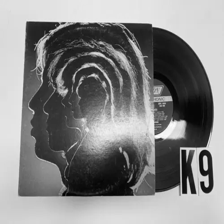

1/1 [==============================] - 0s 32ms/step
extracting image: YD8AAOSwz7lldyQ4_s-l500.webp


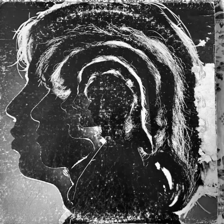

1/1 [==============================] - 0s 32ms/step
extracting image: dqIAAOSwjqlmKbzK_s-l1600.webp


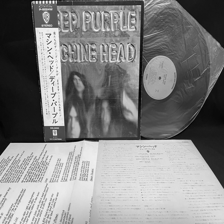

1/1 [==============================] - 0s 33ms/step
extracting image: yyEAAOSwwc1l07-0_s-l500.webp


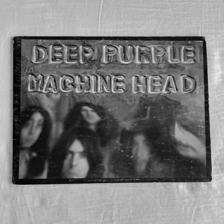

1/1 [==============================] - 0s 32ms/step
extracting image: x6UAAOSwXBlmNPGw_s-l500.webp


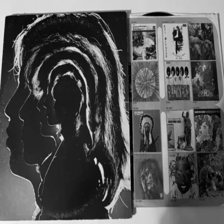

1/1 [==============================] - 0s 31ms/step
extracting image: lTkAAOSwrcFmHeUp_s-l500.webp


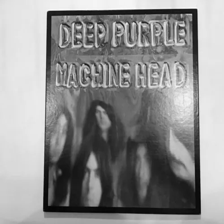

1/1 [==============================] - 0s 32ms/step
extracting image: ~4EAAOSwO1RmLRxd_s-l500.webp


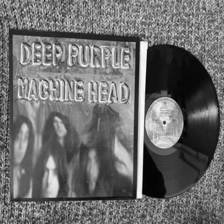

1/1 [==============================] - 0s 30ms/step
extracting image: jzQAAOSwAQ5l6Dfl_s-l1600.webp


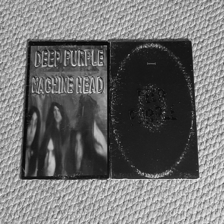

1/1 [==============================] - 0s 28ms/step
extracting image: OiUAAOSwiGNmLswo_s-l1600.webp


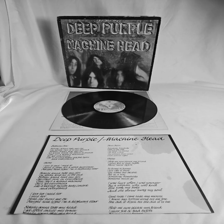

1/1 [==============================] - 0s 28ms/step
extracting image: K9YAAOSwRKxmK3xx_s-l500.webp


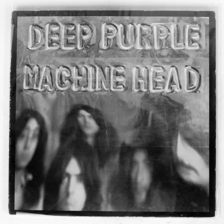

1/1 [==============================] - 0s 29ms/step
extracting image: plkAAOSwgb9mKbxC_s-l500.webp


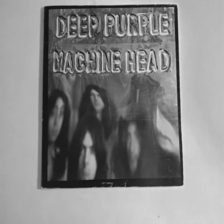

1/1 [==============================] - 0s 29ms/step
extracting image: ulwAAOSwCmNmIPyD_s-l500.webp


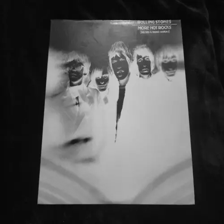

1/1 [==============================] - 0s 32ms/step
extracting image: XfAAAOSw8SdmFZEB_s-l1600.webp


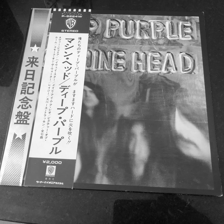

1/1 [==============================] - 0s 28ms/step
extracting image: zaYAAOSw2URkzTle_s-l1600.webp


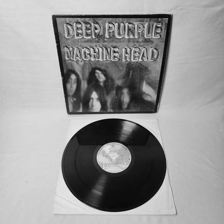

1/1 [==============================] - 0s 28ms/step
extracting image: Ar8AAOSwqY9mNU7n_s-l500.webp


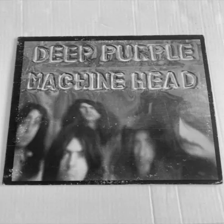

1/1 [==============================] - 0s 29ms/step
extracting image: qpoAAOSwiexl~Uhs_s-l500.webp


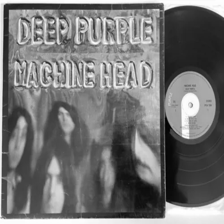

1/1 [==============================] - 0s 30ms/step
extracting image: VAgAAOSw4olmBvBU_s-l500.webp


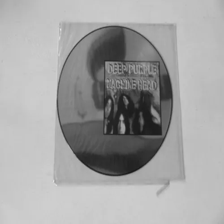

1/1 [==============================] - 0s 31ms/step
extracting image: u3MAAOSwi7VmLgte_s-l500.webp


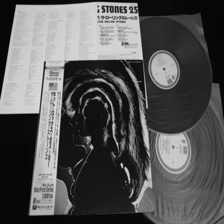

1/1 [==============================] - 0s 32ms/step
extracting image: ZAkAAOSw7rZlLSkj_s-l500.webp


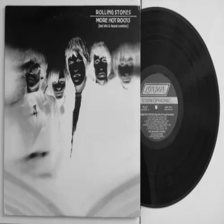

1/1 [==============================] - 0s 33ms/step
extracting image: AU8AAOSwgoJmGNhK_s-l500.webp


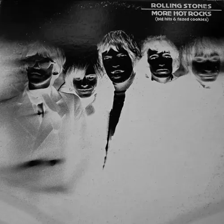

1/1 [==============================] - 0s 31ms/step
extracting image: vUEAAOSwinNmCtgF_s-l500.webp


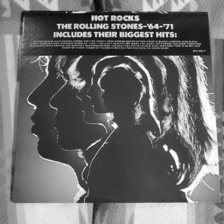

1/1 [==============================] - 0s 32ms/step
extracting image: KIQAAOSwqyxmCYGA_s-l500.webp


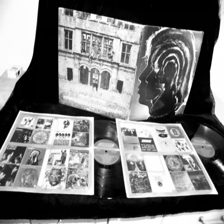

1/1 [==============================] - 0s 32ms/step
extracting image: wtIAAOSwNJxmJ3xH_s-l500.webp


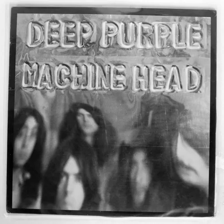

1/1 [==============================] - 0s 30ms/step
extracting image: cT8AAOSwb7NggX7w_s-l500.webp


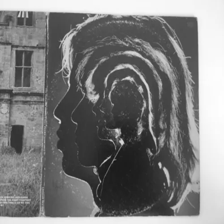

1/1 [==============================] - 0s 30ms/step
extracting image: bpgAAOSw8slmEITN_s-l1600.webp


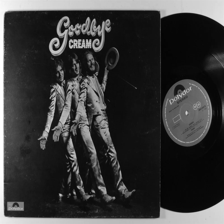

1/1 [==============================] - 0s 30ms/step
extracting image: cR0AAOSwWt1mC3tL_s-l300.webp


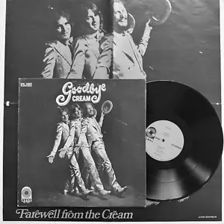

1/1 [==============================] - 0s 29ms/step
extracting image: pnIAAOSwkt9mIGgT_s-l500.webp


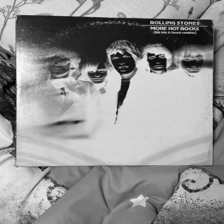

1/1 [==============================] - 0s 28ms/step
extracting image: g8QAAOSwqZpmLB4Y_s-l500.webp


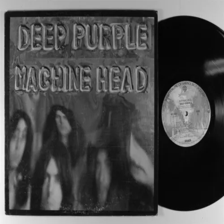

1/1 [==============================] - 0s 29ms/step
extracting image: OB0AAOSwxuNmJprR_s-l1600.webp


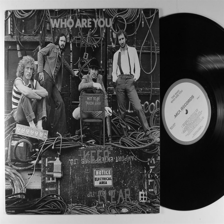

1/1 [==============================] - 0s 30ms/step
extracting image: 4B4AAOSwaTpmK4b5_s-l500.webp


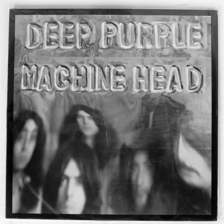

1/1 [==============================] - 0s 29ms/step
extracting image: R~kAAOSw~JJmDWj8_s-l1600.webp


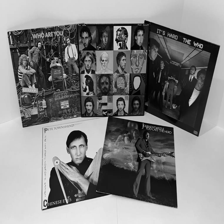

1/1 [==============================] - 0s 28ms/step
extracting image: p5kAAOSwhFJlwgD3_s-l1600.webp


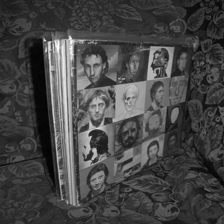

1/1 [==============================] - 0s 29ms/step
extracting image: yoUAAOSwzxlmL86A_s-l1600.webp


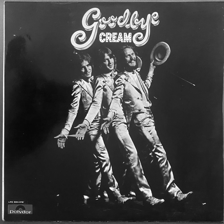

1/1 [==============================] - 0s 28ms/step
extracting image: e5sAAOSwqU1lbVjc_s-l500.webp


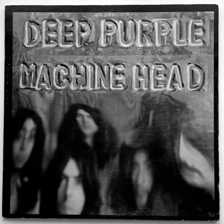

1/1 [==============================] - 0s 28ms/step
extracting image: ZUIAAOSwFkZmD1d-_s-l1600.webp


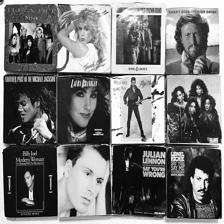

1/1 [==============================] - 0s 29ms/step
extracting image: ~g8AAOSwqh9mH4JO_s-l1600.webp


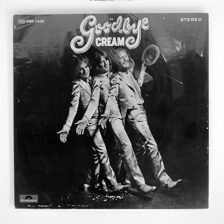

1/1 [==============================] - 0s 29ms/step
extracting image: zO8AAOSwHShmAysG_s-l1600.webp


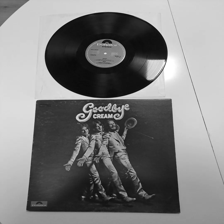

1/1 [==============================] - 0s 30ms/step
extracting image: yuYAAOSwEylmCHfp_s-l1600.webp


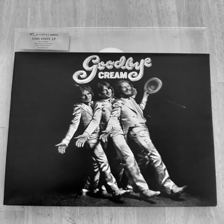

1/1 [==============================] - 0s 31ms/step
extracting image: NWYAAOSw2GpfKfja_s-l500.webp


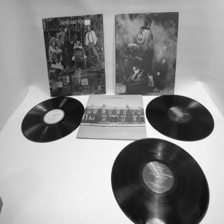

1/1 [==============================] - 0s 29ms/step
extracting image: DWUAAOSwMC5l5rF2_s-l500.webp


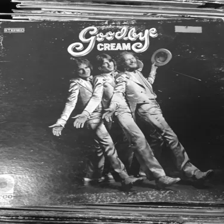

1/1 [==============================] - 0s 29ms/step
extracting image: WGMAAOSwXatlQRY8_s-l500.webp


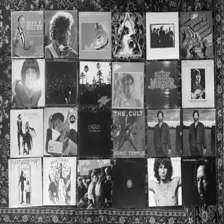

1/1 [==============================] - 0s 28ms/step
extracting image: ~LAAAOSwjJtl6hp8_s-l500.webp


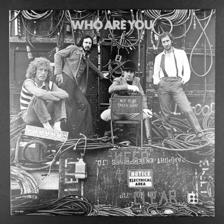

1/1 [==============================] - 0s 30ms/step
extracting image: SyEAAOSwnYxmN2aC_s-l1600.webp


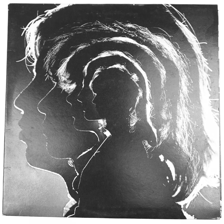

1/1 [==============================] - 0s 27ms/step
extracting image: ZHYAAOSwdVNlN-sa_s-l300.webp


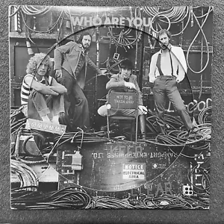

1/1 [==============================] - 0s 27ms/step
extracting image: cOEAAOSwAx9lnBCg_s-l500.webp


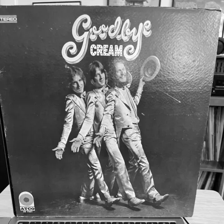

1/1 [==============================] - 0s 27ms/step
extracting image: OakAAOSwsPpmAyKk_s-l500.webp


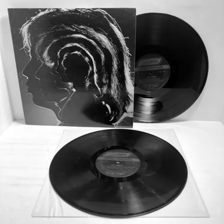

1/1 [==============================] - 0s 28ms/step
extracting image: VvEAAOSw88ZkhjTA_s-l500.webp


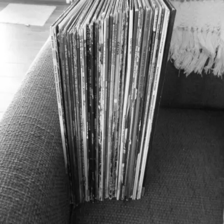

1/1 [==============================] - 0s 30ms/step
extracting image: RhgAAOSwWLhmJrtK_s-l500.webp


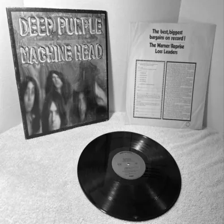

1/1 [==============================] - 0s 29ms/step
extracting image: LcsAAOSwl49mIFDR_s-l1600.webp


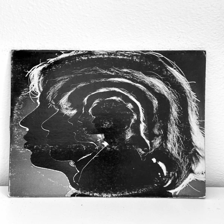

1/1 [==============================] - 0s 30ms/step
extracting image: u3cAAOSwu3BmGw1r_s-l1600.webp


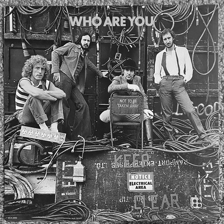

1/1 [==============================] - 0s 29ms/step
extracting image: BMUAAOSwXGBmN1wr_s-l500.webp


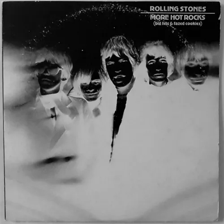

1/1 [==============================] - 0s 28ms/step
extracting image: 3VYAAOSwcEtmJ-tX_s-l1600.webp


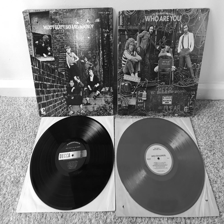

1/1 [==============================] - 0s 29ms/step
extracting image: CQsAAOSwCyFmK4Z-_s-l500.webp


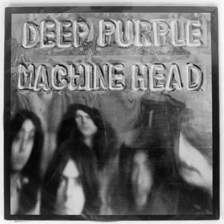

1/1 [==============================] - 0s 28ms/step
extracting image: BnUAAOSwSGpmBjL5_s-l300.webp


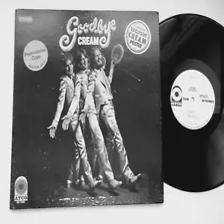

1/1 [==============================] - 0s 27ms/step
extracting image: 1dsAAOSwXmpmIeUH_s-l500.webp


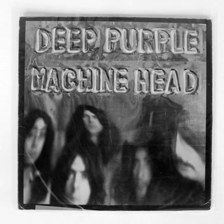

1/1 [==============================] - 0s 28ms/step
extracting image: xgAAAOSwyAJmH-ta_s-l1600.webp


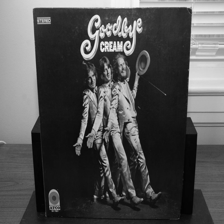

1/1 [==============================] - 0s 27ms/step
extracting image: Lz0AAOSwjmdlH0kU_s-l1600.webp


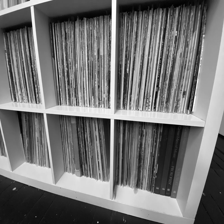

1/1 [==============================] - 0s 29ms/step
extracting image: TGcAAOSwojRly78q_s-l500.webp


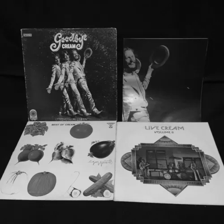

1/1 [==============================] - 0s 28ms/step
extracting image: rogAAOSwhHdmGapm_s-l500.webp


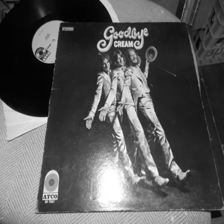

1/1 [==============================] - 0s 28ms/step
extracting image: UL0AAOSwy2lmBmuc_s-l1600.webp


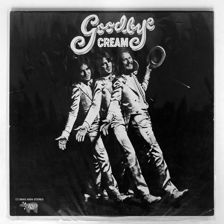

1/1 [==============================] - 0s 28ms/step
extracting image: 3YwAAOSwZJRlzm0t_s-l500.webp


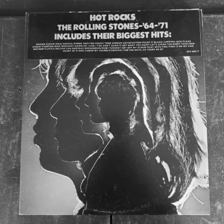

1/1 [==============================] - 0s 29ms/step
extracting image: xpYAAOSwLxhmH4Mu_s-l500.webp


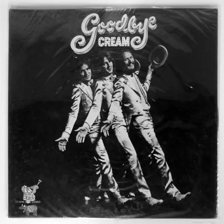

1/1 [==============================] - 0s 26ms/step
extracting image: VrwAAOSwT7ZjKO~M_s-l500.webp


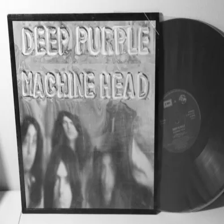

1/1 [==============================] - 0s 28ms/step
extracting image: VvEAAOSw88ZkhjTA_s-l500.webp


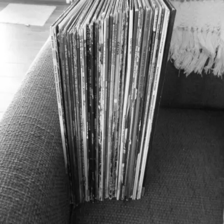

1/1 [==============================] - 0s 27ms/step
extracting image: -AoAAOSwpSdl7GU8_s-l1600.webp


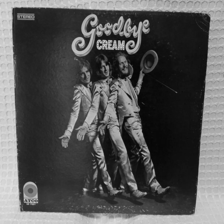

1/1 [==============================] - 0s 27ms/step
extracting image: QcQAAOSwvw5jxdLD_s-l500.webp


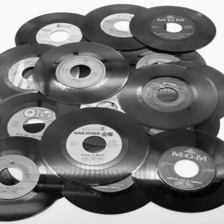

1/1 [==============================] - 0s 31ms/step
extracting image: rjUAAOSwZ2llwAVe_s-l1600.webp


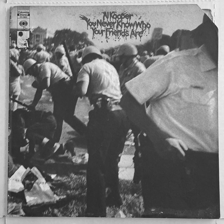

1/1 [==============================] - 0s 27ms/step
extracting image: 0nwAAOSwhXlmJ2Ao_s-l1600.jpg


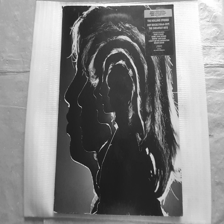

1/1 [==============================] - 0s 28ms/step
extracting image: ZmsAAOSwKCJmHCtS_s-l500.webp


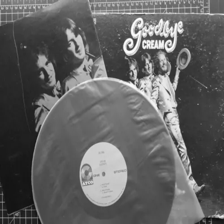

1/1 [==============================] - 0s 34ms/step
extracting image: eoQAAOSwjrlmHjzb_s-l500.webp


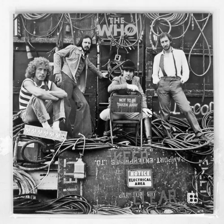

1/1 [==============================] - 0s 31ms/step
extracting image: CWwAAOSwIVdmIXIR_s-l500.webp


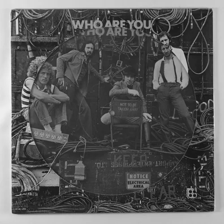

1/1 [==============================] - 0s 29ms/step
extracting image: 56MAAOSwzW9mILHl_s-l500.webp


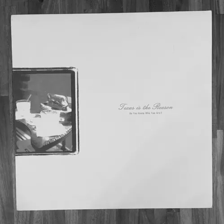

1/1 [==============================] - 0s 28ms/step
extracting image: E9gAAOSwM5tmHIgg_s-l500.webp


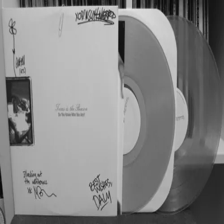

1/1 [==============================] - 0s 28ms/step
extracting image: O38AAOSw679mKMQ8_s-l300.webp


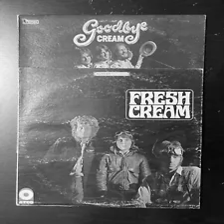

1/1 [==============================] - 0s 30ms/step
extracting image: ~CAAAOSw5D9mACmj_s-l500.webp


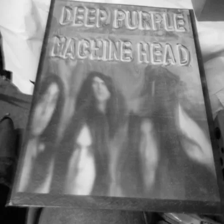

1/1 [==============================] - 0s 27ms/step
extracting image: 0XAAAOSwT9llw7JL_s-l500.webp


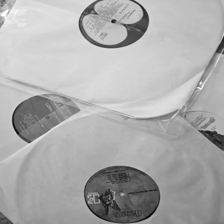

1/1 [==============================] - 0s 28ms/step
extracting image: 46MAAOSwZYxlMtGF_s-l1600.webp


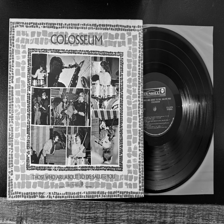

1/1 [==============================] - 0s 28ms/step
extracting image: 4GUAAOSwiL9ijb-t_s-l1600.webp


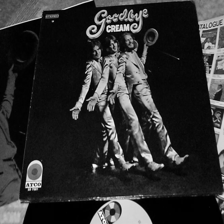

1/1 [==============================] - 0s 29ms/step
extracting image: KSMAAOSw~CtmMo2u_s-l500.webp


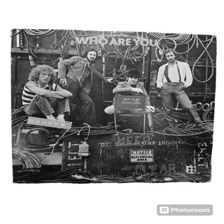

1/1 [==============================] - 0s 28ms/step
extracting image: blEAAOSwlCFl-JkT_s-l300.webp


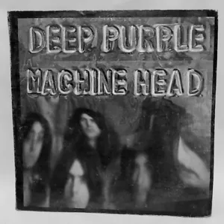

1/1 [==============================] - 0s 28ms/step
extracting image: 0~YAAOSw6ldlrQMh_s-l500.webp


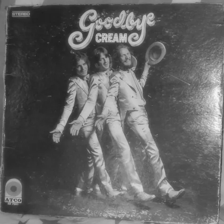

1/1 [==============================] - 0s 28ms/step
extracting image: LkcAAOSwxHFmGyi-_s-l500.webp


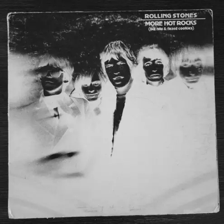

1/1 [==============================] - 0s 28ms/step
extracting image: dR4AAOSwVQpmGrDd_s-l500.webp


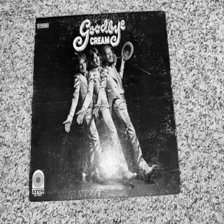

1/1 [==============================] - 0s 27ms/step
extracting image: puYAAOSwlYdmGSth_s-l500.webp


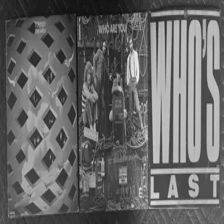

1/1 [==============================] - 0s 28ms/step
extracting image: ZJoAAOSwL1xkUkky_s-l300.webp


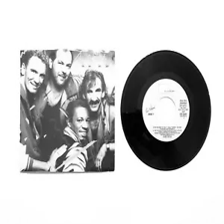

1/1 [==============================] - 0s 27ms/step
extracting image: qBkAAOSwLqZlwWRX_s-l1600.webp


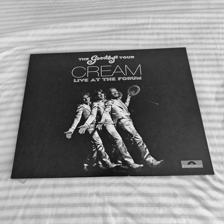

1/1 [==============================] - 0s 28ms/step
extracting image: WlwAAOSwBuxmK3xy_s-l1600.webp


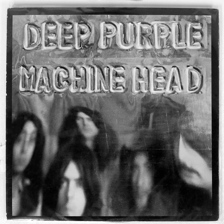

1/1 [==============================] - 0s 27ms/step
extracting image: L3QAAOSwT8BmEMgU_s-l500.webp


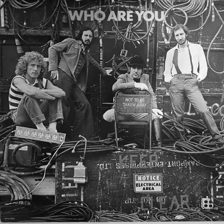

1/1 [==============================] - 0s 28ms/step
extracting image: C9MAAOSwCftmJZy8_s-l500.webp


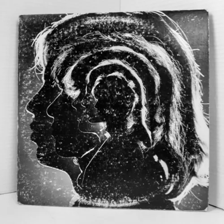

1/1 [==============================] - 0s 28ms/step
extracting image: 9sAAAOSw1n5l3OjR_s-l500.webp


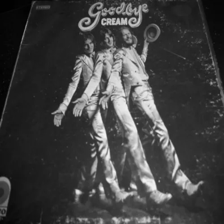

1/1 [==============================] - 0s 28ms/step
extracting image: JH4AAOSw36BmM9k-_s-l500.webp


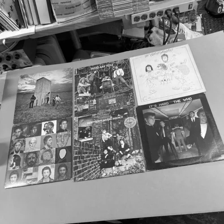

1/1 [==============================] - 0s 28ms/step
extracting image: xcIAAOSw181mKHAU_s-l1600.webp


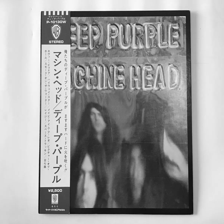

1/1 [==============================] - 0s 29ms/step
extracting image: 11sAAOSwDmpmNHR3_s-l500.webp


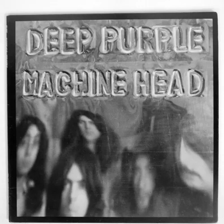

1/1 [==============================] - 0s 26ms/step
extracting image: kQEAAOSwVbBmIXp7_s-l500.webp


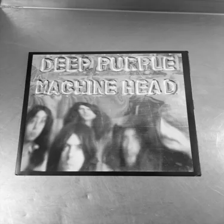

1/1 [==============================] - 0s 29ms/step
extracting image: Cr0AAOSw535mCFxO_s-l1600.webp


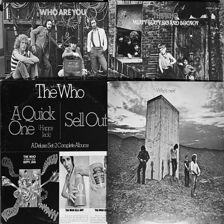

1/1 [==============================] - 0s 28ms/step
extracting image: AEwAAOSwnoplsoso_s-l500.webp


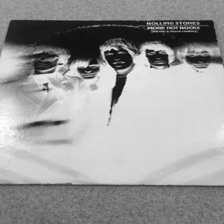

1/1 [==============================] - 0s 29ms/step
extracting image: N~kAAOSwsTVl1Woa_s-l1600.webp


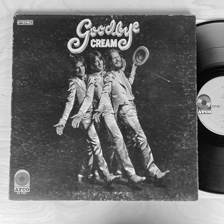

1/1 [==============================] - 0s 28ms/step
extracting image: O~oAAOSwm~pmOUfZ_s-l1600.webp


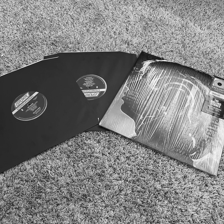

1/1 [==============================] - 0s 29ms/step
extracting image: WJ0AAOSwNFZl45Hr_s-l500.webp


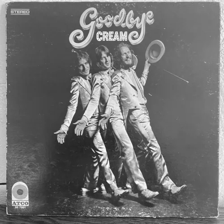

1/1 [==============================] - 0s 29ms/step
extracting image: Y5oAAOSwWZZjLN2Z_s-l1600.webp


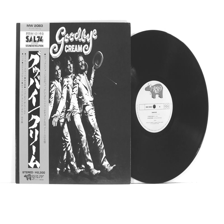

1/1 [==============================] - 0s 27ms/step
extracting image: QIUAAOSwCbRlLiha_s-l1600.webp


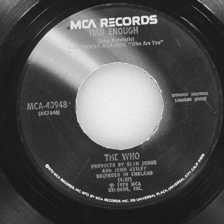

1/1 [==============================] - 0s 28ms/step
extracting image: e98AAOSwxYxl-de7_s-l300.webp


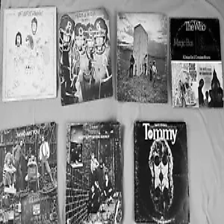

1/1 [==============================] - 0s 28ms/step
extracting image: OGQAAOSwd9BmIeH3_s-l500.webp


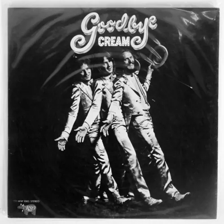

1/1 [==============================] - 0s 28ms/step
extracting image: l8cAAOSwYS9mHvcw_s-l500.webp


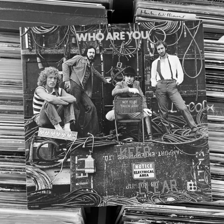

1/1 [==============================] - 0s 29ms/step
extracting image: wA4AAOSwsO9mIgFT_s-l500.webp


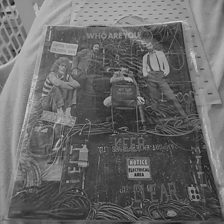

1/1 [==============================] - 0s 28ms/step
extracting image: JXAAAOSwi5NmKe20_s-l500.webp


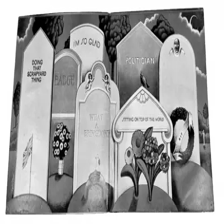

1/1 [==============================] - 0s 28ms/step
extracting image: 9TkAAOSwWSZmKJGr_s-l500.webp


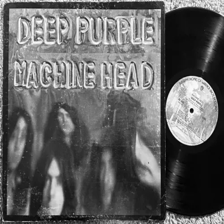

1/1 [==============================] - 0s 28ms/step
extracting image: snIAAOSwOyJmGiPG_s-l500.webp


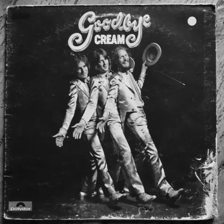

1/1 [==============================] - 0s 27ms/step
extracting image: INwAAOSwOyhjRHh3_s-l1600.webp


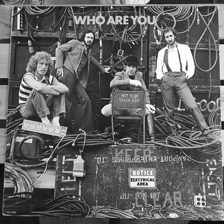

1/1 [==============================] - 0s 28ms/step
extracting image: q4wAAOSwvGdmHZr8_s-l500.webp


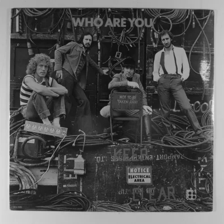

1/1 [==============================] - 0s 29ms/step
extracting image: XmAAAOSw519mH~OL_s-l500.webp


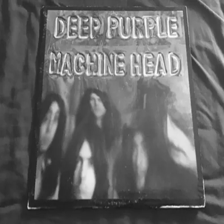

1/1 [==============================] - 0s 28ms/step
extracting image: OaAAAOSwwTtgE1qq_s-l500.webp


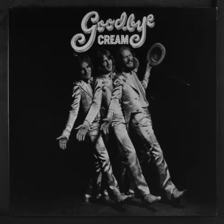

1/1 [==============================] - 0s 28ms/step
extracting image: oOkAAOSwrVRfvADy_s-l500.webp


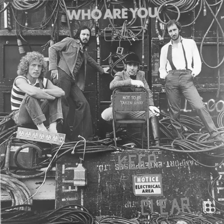

1/1 [==============================] - 0s 27ms/step
extracting image: H2MAAOSwJ5pmIFSB_s-l500.webp


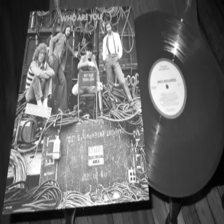

1/1 [==============================] - 0s 30ms/step
extracting image: ~WwAAOSwP8Vk0RLz_s-l500.webp


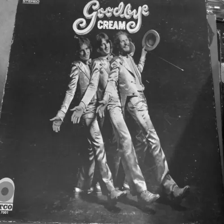

1/1 [==============================] - 0s 28ms/step
extracting image: pSUAAOSwD3pkfVgA_s-l1600.webp


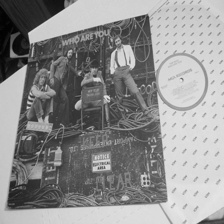

1/1 [==============================] - 0s 29ms/step
extracting image: e00AAOSwJ0RmGtnl_s-l1600.webp


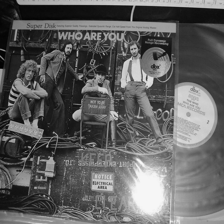

1/1 [==============================] - 0s 28ms/step
extracting image: FuMAAOSwx7Rl4SXw_s-l500.webp


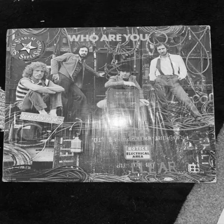

1/1 [==============================] - 0s 28ms/step
extracting image: VZQAAOSw9Q1mHY74_s-l1600.webp


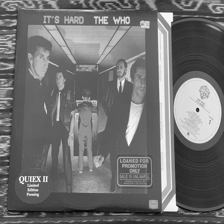

1/1 [==============================] - 0s 28ms/step
extracting image: jygAAOSwuxZmFfZr_s-l500.webp


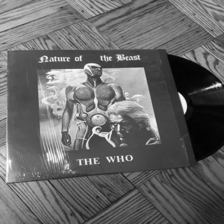

1/1 [==============================] - 0s 27ms/step
extracting image: d6sAAOSwiaRmMFR1_s-l1600.webp


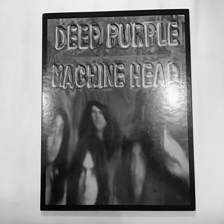

1/1 [==============================] - 0s 29ms/step
extracting image: Wl4AAOSw6vVl8nxq_s-l300.webp


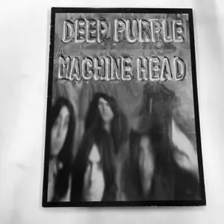

1/1 [==============================] - 0s 28ms/step
extracting image: tLcAAOSwWgtlHc8x_s-l500.webp


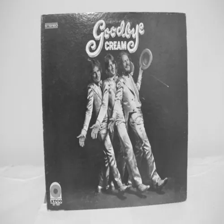

1/1 [==============================] - 0s 28ms/step
extracting image: rEsAAOSw-mhmK4bQ_s-l500.webp


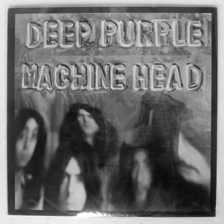

1/1 [==============================] - 0s 28ms/step
extracting image: NYUAAOSwE5NkLyx-_s-l500.webp


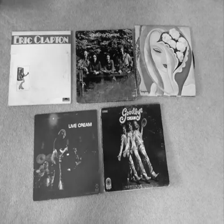

1/1 [==============================] - 0s 28ms/step
extracting image: OawAAOSwaKpkENYz_s-l1600.webp


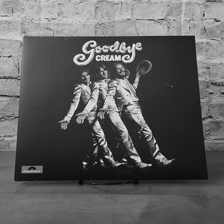

1/1 [==============================] - 0s 28ms/step
extracting image: A64AAOSwP-BmK4Lt_s-l500.webp


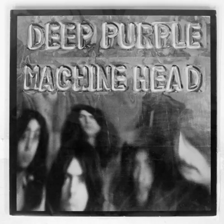

1/1 [==============================] - 0s 28ms/step
extracting image: reoAAOSwmwxmApk6_s-l500.webp


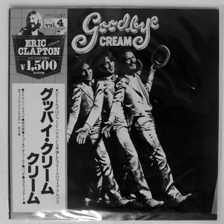

1/1 [==============================] - 0s 29ms/step
extracting image: 4EMAAOSwEOplxWRX_s-l300.webp


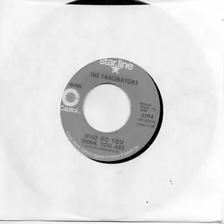

1/1 [==============================] - 0s 27ms/step
extracting image: -MsAAOSwjBtmBgT1_s-l500.webp


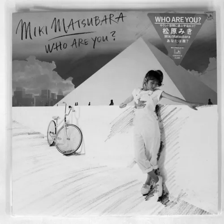

1/1 [==============================] - 0s 27ms/step
extracting image: o0wAAOSwKAVl-~~2_s-l1600.webp


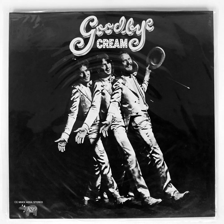

1/1 [==============================] - 0s 28ms/step
extracting image: qwoAAOSwAftkgNji_s-l500.jpg


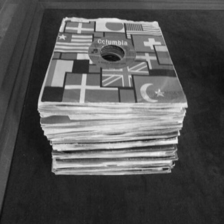

1/1 [==============================] - 0s 28ms/step
extracting image: rC8AAOSwztBmGRfv_s-l500.webp


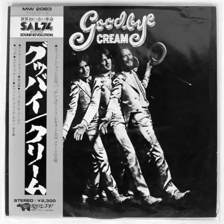

1/1 [==============================] - 0s 28ms/step
extracting image: wtsAAOSw1cpjhQAp_s-l1600.webp


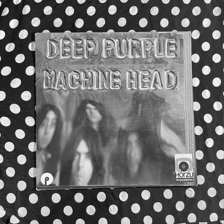

1/1 [==============================] - 0s 27ms/step
extracting image: IKoAAOSwNH9mL~~f_s-l1600.webp


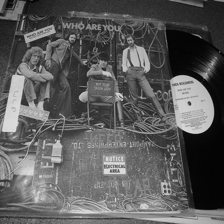

1/1 [==============================] - 0s 29ms/step
extracting image: 8AUAAOSwRkRjnCOV_s-l300.webp


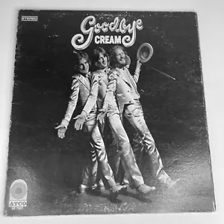

1/1 [==============================] - 0s 29ms/step
extracting image: ghkAAOSwK6xlhU9C_s-l500.webp


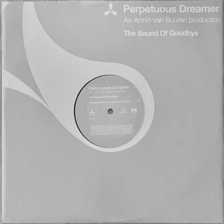

1/1 [==============================] - 0s 28ms/step
extracting image: jIcAAOSw6jlmAiZe_s-l1600.webp


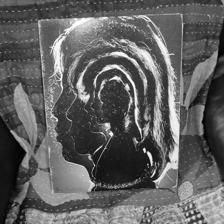

1/1 [==============================] - 0s 28ms/step
extracting image: AtAAAOSwbKFmIeFt_s-l1600.webp


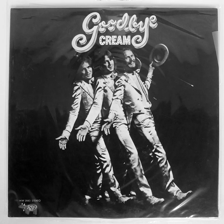

1/1 [==============================] - 0s 29ms/step
extracting image: 6pUAAOSwkoxmHBFY_s-l500.webp


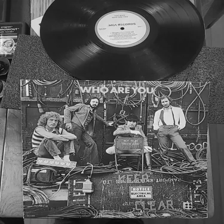

1/1 [==============================] - 0s 29ms/step
extracting image: oXAAAOSwu1Vlx85E_s-l1600.webp


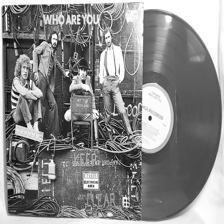

1/1 [==============================] - 0s 27ms/step
extracting image: KvMAAOSwsbtmLIk3_s-l300.webp


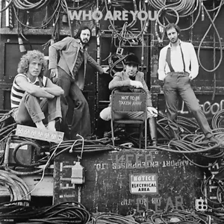

1/1 [==============================] - 0s 28ms/step
extracting image: Vq0AAOSw20VmIALi_s-l500.webp


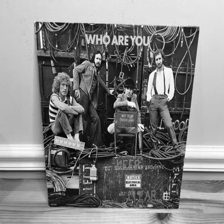

1/1 [==============================] - 0s 28ms/step
extracting image: oq8AAOSwu8RmIJ7b_s-l500.webp


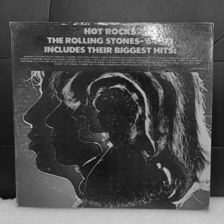

1/1 [==============================] - 0s 27ms/step
extracting image: ~SoAAOSwUUVmHD25_s-l500.webp


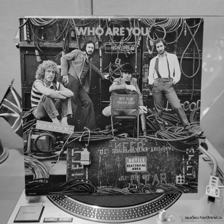

1/1 [==============================] - 0s 27ms/step
extracting image: gwQAAOSwodlmK4VQ_s-l500.webp


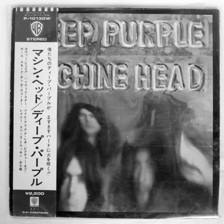

1/1 [==============================] - 0s 28ms/step
extracting image: iHgAAOSwFnFmHW7u_s-l500.webp


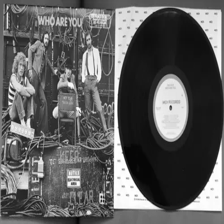

1/1 [==============================] - 0s 27ms/step
extracting image: UKkAAOSwMGNmIIg-_s-l1600.webp


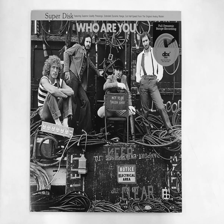

1/1 [==============================] - 0s 29ms/step
extracting image: g3UAAOSwRxhlzAzV_s-l500.webp


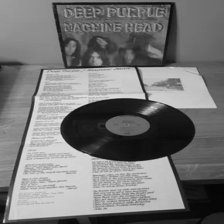

1/1 [==============================] - 0s 28ms/step
extracting image: w7sAAOSwRpNmJ3zK_s-l500.webp


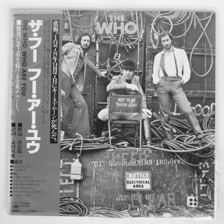

1/1 [==============================] - 0s 28ms/step
extracting image: 5ykAAOSwCOtkRZ9A_s-l500.webp


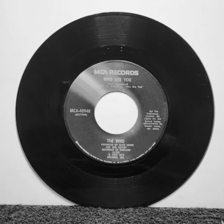

1/1 [==============================] - 0s 29ms/step
extracting image: 4RAAAOSwJqNlsZUz_s-l500.webp


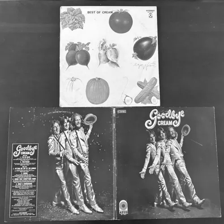

1/1 [==============================] - 0s 30ms/step
extracting image: Sq8AAOSw8KRl88Ej_s-l500.webp


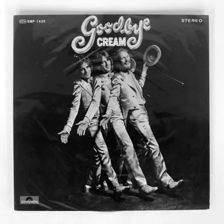

1/1 [==============================] - 0s 29ms/step
extracting image: MlEAAOSwQi9j0qGP_s-l500.webp


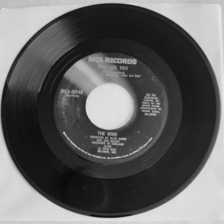

1/1 [==============================] - 0s 27ms/step
extracting image: UcMAAOSwT-1lV6qO_s-l500.webp


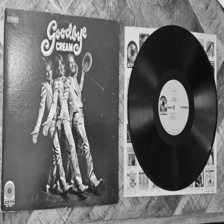

1/1 [==============================] - 0s 29ms/step
extracting image: BysAAOSwQ69lhPcg_s-l1600.webp


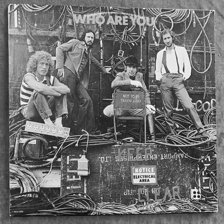

1/1 [==============================] - 0s 28ms/step
extracting image: MFIAAOSwKo1lrEwE_s-l500.webp


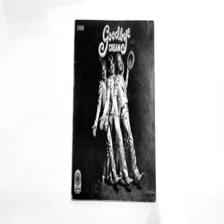

1/1 [==============================] - 0s 28ms/step
extracting image: bNAAAOSwsBBlrZJ2_s-l500.webp


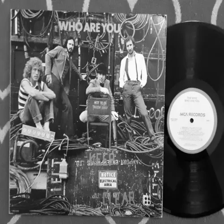

1/1 [==============================] - 0s 27ms/step
extracting image: kCkAAOSwpYNkfLLD_s-l300.webp


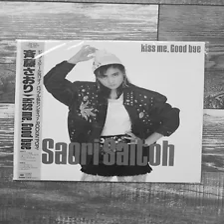

1/1 [==============================] - 0s 27ms/step
extracting image: C3sAAOSwmplmFQ9i_s-l1600.webp


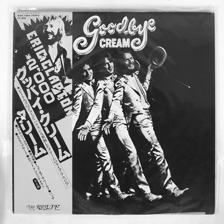

1/1 [==============================] - 0s 27ms/step
extracting image: yN8AAOSwZj1gGB1A_s-l1600.webp


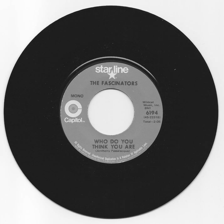

1/1 [==============================] - 0s 28ms/step
extracting image: -WUAAOSwdzpmGAIh_s-l500.webp


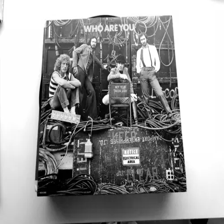

1/1 [==============================] - 0s 27ms/step
extracting image: 3HQAAOSw-ylmMv0U_s-l1600.webp


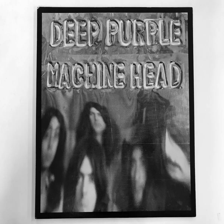

1/1 [==============================] - 0s 28ms/step
extracting image: D~AAAOSw6ell12qB_s-l500.webp


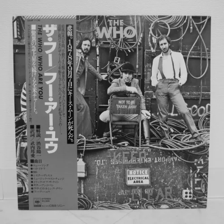

1/1 [==============================] - 0s 27ms/step
extracting image: rO4AAOSwRaplSZAA_s-l1600.webp


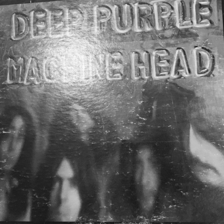

1/1 [==============================] - 0s 29ms/step
extracting image: zDIAAOSwLstl7R-Y_s-l1600.webp


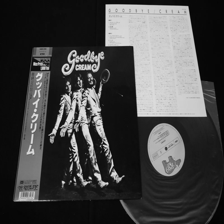

1/1 [==============================] - 0s 28ms/step
extracting image: m98AAOSw2wZl4gzv_s-l500.webp


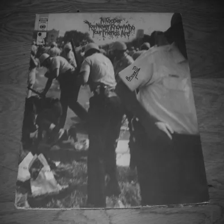

1/1 [==============================] - 0s 28ms/step
extracting image: 5AgAAOSwmV1l6IyE_s-l500.webp


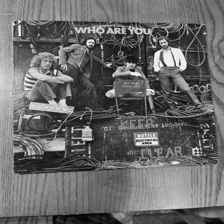

1/1 [==============================] - 0s 28ms/step
extracting image: XR8AAOSwEqNmKHXJ_s-l500.webp


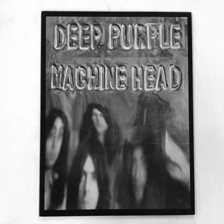

1/1 [==============================] - 0s 28ms/step
extracting image: ukoAAOSwpa9mHMFL_s-l500.webp


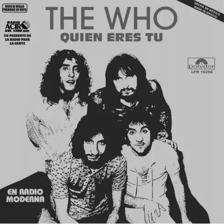

1/1 [==============================] - 0s 28ms/step
extracting image: C7QAAOSwwfpmIjHX_s-l500.webp


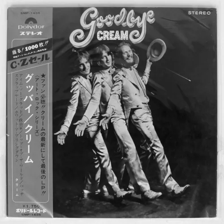

1/1 [==============================] - 0s 30ms/step
extracting image: 1TkAAOSw-mhmJzNd_s-l300.webp


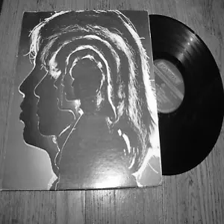

1/1 [==============================] - 0s 30ms/step
extracting image: J20AAOSwhtZmK3zs_s-l500.webp


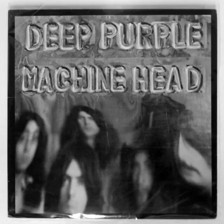

1/1 [==============================] - 0s 29ms/step
extracting image: gPoAAOSwIp1mLatB_s-l1600.webp


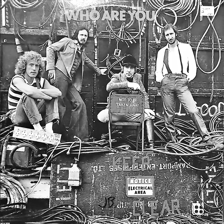

1/1 [==============================] - 0s 28ms/step
extracting image: yDMAAOSwZA9mIjJK_s-l1600.webp


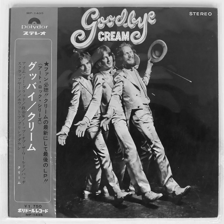

1/1 [==============================] - 0s 28ms/step
extracting image: 0mYAAOSwJhFl8AZa_s-l500.webp


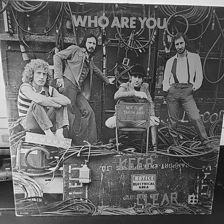

1/1 [==============================] - 0s 28ms/step
extracting image: tkcAAOSw101mImeD_s-l500.webp


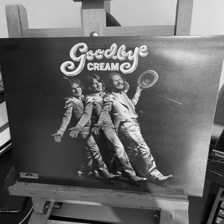

1/1 [==============================] - 0s 28ms/step
extracting image: PBMAAOSwU51mMk4d_s-l1600.webp


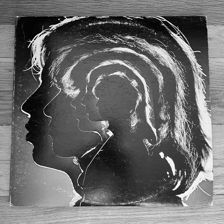

1/1 [==============================] - 0s 39ms/step
extracting image: qrcAAOSwsW5mL-2G_s-l500.webp


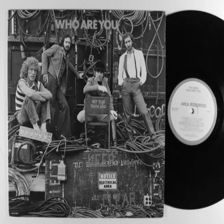

1/1 [==============================] - 0s 28ms/step
extracting image: 9aoAAOSwKlxmIat7_s-l500.webp


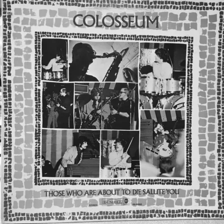

1/1 [==============================] - 0s 27ms/step
extracting image: m~cAAOSwtsNl7JGP_s-l500.webp


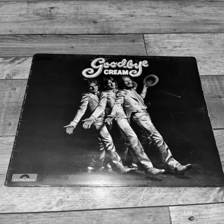

1/1 [==============================] - 0s 29ms/step


In [17]:
image_files = np.array(df.loc[0:,'image_file'])
embeddings = [] 
for image in image_files:
    print('extracting image:', image)
    embedding = extract('scraping/files/' + image)
    embedding = list(embedding)
    row = [image, embedding]
    embeddings.append(row)
#add embedding to df for image
# Create a dictionary from the embeddings list
embeddings_dict = {name: embedding for name, embedding in embeddings}
# Update the 'image_embedding' column
df['image_embedding'] = df['image_file'].map(embeddings_dict)

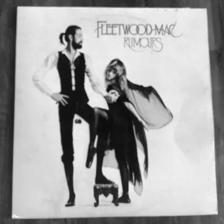

1/1 [==============================] - 0s 31ms/step


In [18]:
# get embeddings from a new image to compare to our dataset
origin_embedding = extract('input-images/' + 'origin-image.webp')
origin_embedding = list(origin_embedding)

In [19]:
from scipy.spatial import distance
metric = 'cosine'

In [20]:
# run through df embeddings and calc cosine distance from original image then order smallest
# to largest with filename as reference
image_embeddings = np.array(df.iloc[:, [12, 13]])
distances = []
for i in range(len(image_embeddings)):
    image_file = df.iloc[i, 12]
    image_embedding = df.iloc[i, 13]
    dist = float(distance.cdist([origin_embedding], [image_embedding], metric)[0])
    row = [image_file, dist]
    distances.append(row) 
distances = sorted(distances, reverse = True) 

In [21]:
sorted_distances = sorted(distances, key=lambda x: x[1])

Your items value based on 410 comparable items sold is:

--$ 28.49846341463415 --

-> Min Price sold: $ 0.99
-> Max Price sold: $ 718.0
 
Details -> Top  410  most similar items found:



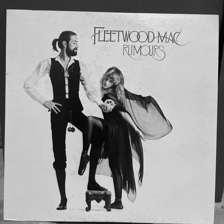

Distance from original: 0.11478539226126194


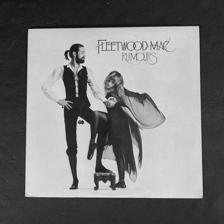

Distance from original: 0.11573746559560372


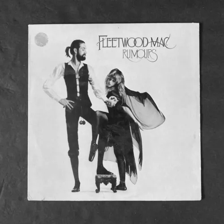

Distance from original: 0.11746705302444127


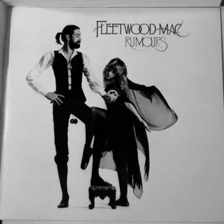

Distance from original: 0.13031336994706189


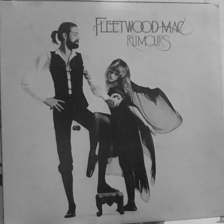

Distance from original: 0.13125913989174764


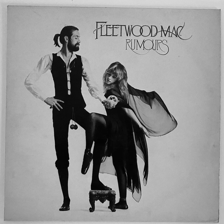

Distance from original: 0.13563509435169507


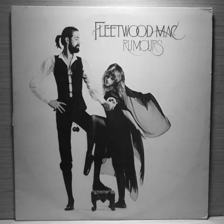

Distance from original: 0.13672209836427318


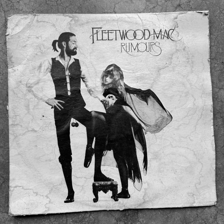

Distance from original: 0.1618686949625665


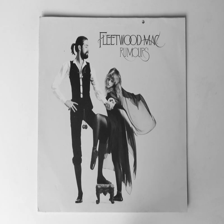

Distance from original: 0.1803764087608748


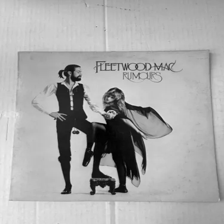

Distance from original: 0.18155194199840097


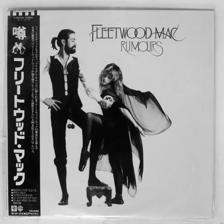

Distance from original: 0.18233034601270692


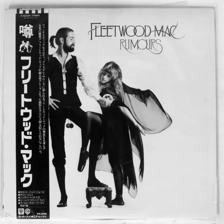

Distance from original: 0.1911796142304084


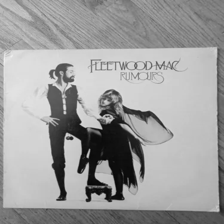

Distance from original: 0.19669821540926602


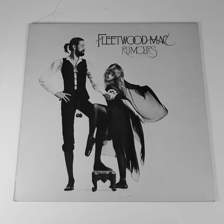

Distance from original: 0.20704364482408333


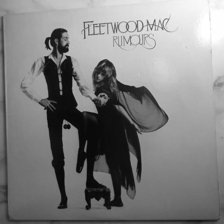

Distance from original: 0.21290399265460236


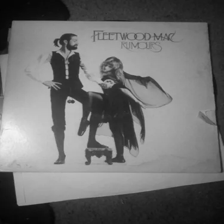

Distance from original: 0.21619193318838226


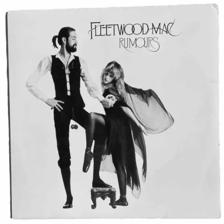

Distance from original: 0.21793042757250947


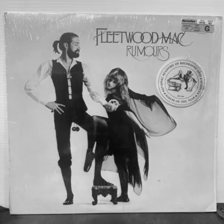

Distance from original: 0.23841689279572242


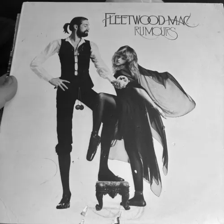

Distance from original: 0.23929293630751058


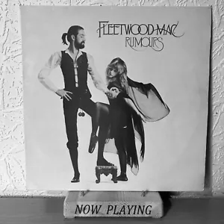

Distance from original: 0.2396602812429247


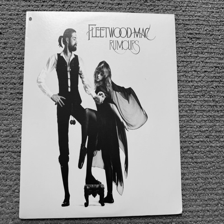

Distance from original: 0.25659099718660283


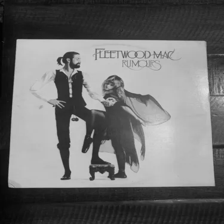

Distance from original: 0.28768862470608714


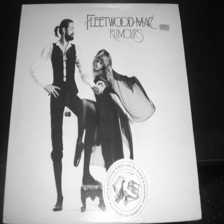

Distance from original: 0.31851892268558124


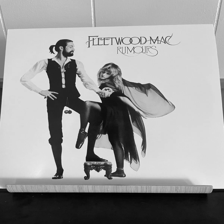

Distance from original: 0.320160116767069


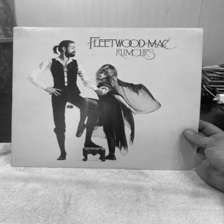

Distance from original: 0.32608211260680064


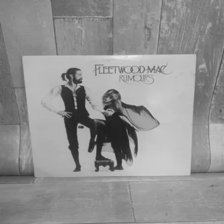

Distance from original: 0.33155027202648624


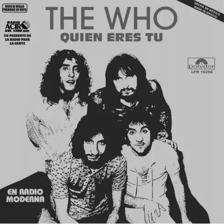

Distance from original: 0.38158759479828286


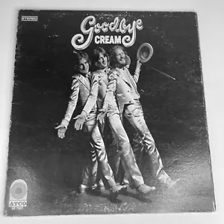

Distance from original: 0.3840286318911621


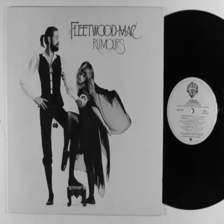

Distance from original: 0.3857557813716286


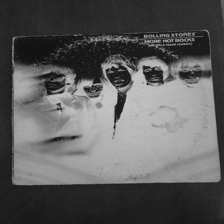

Distance from original: 0.38908016533734635


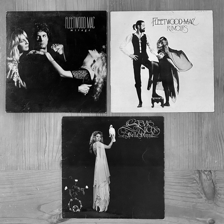

Distance from original: 0.3978036992687697


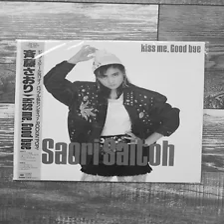

Distance from original: 0.3980844594676808


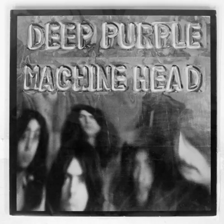

Distance from original: 0.4033264857315322


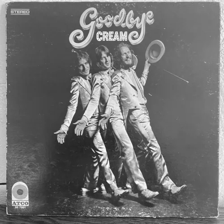

Distance from original: 0.4038869986986239


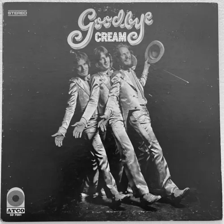

Distance from original: 0.4040627295757393


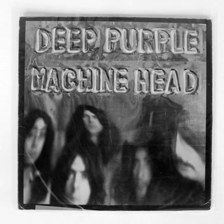

Distance from original: 0.4041819696173501


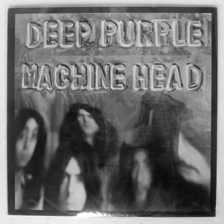

Distance from original: 0.40484921641509


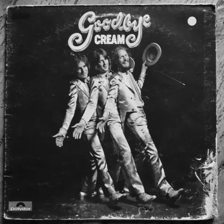

Distance from original: 0.41010208853127506


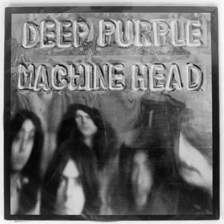

Distance from original: 0.4116344733591647


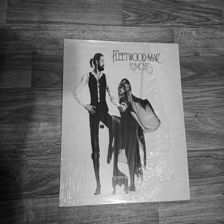

Distance from original: 0.41409503291760263


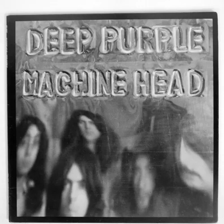

Distance from original: 0.4178110548853907


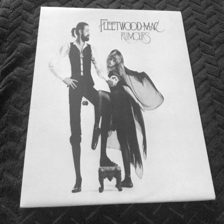

Distance from original: 0.4187639696975204


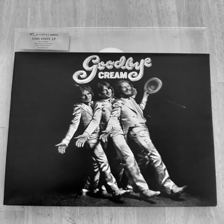

Distance from original: 0.42564901742799943


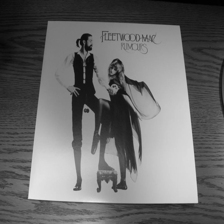

Distance from original: 0.4262934380935516


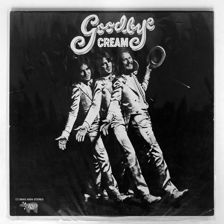

Distance from original: 0.42775706429983495


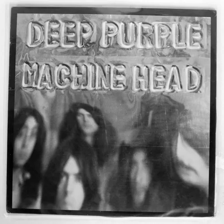

Distance from original: 0.4306035287385762


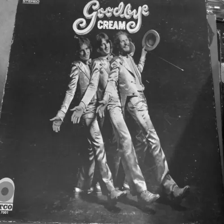

Distance from original: 0.43471184362405


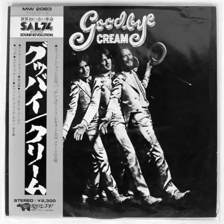

Distance from original: 0.43830274893676135


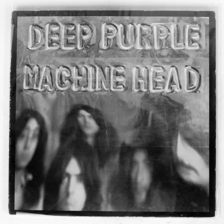

Distance from original: 0.43830340847230675


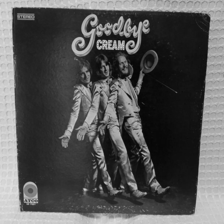

Distance from original: 0.43869530899868237


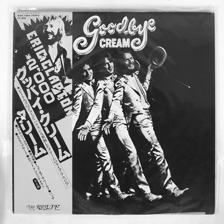

Distance from original: 0.43987816377686895


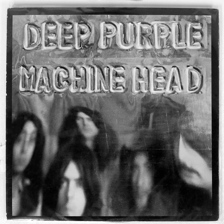

Distance from original: 0.4422437462462162


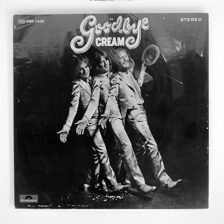

Distance from original: 0.4444315410847035


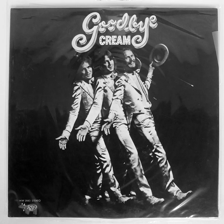

Distance from original: 0.44528563083089634


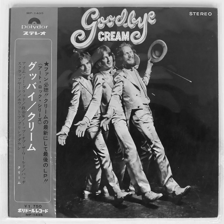

Distance from original: 0.4455875148184921


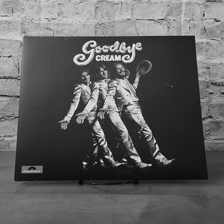

Distance from original: 0.44721084649854914


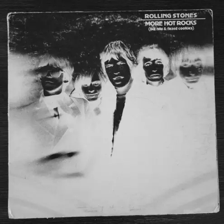

Distance from original: 0.44869456302476296


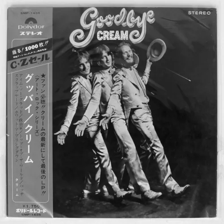

Distance from original: 0.4512488020226144


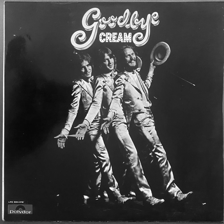

Distance from original: 0.4594368193088789


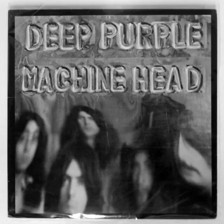

Distance from original: 0.4625170054614913


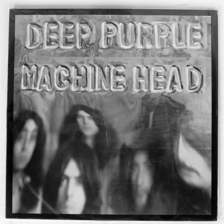

Distance from original: 0.46261722563883634


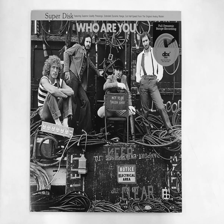

Distance from original: 0.46623735144792533


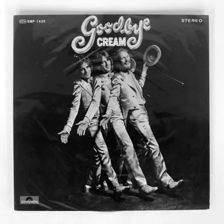

Distance from original: 0.4670019960457066


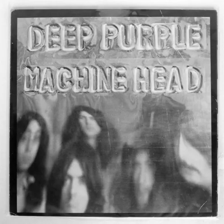

Distance from original: 0.4709737281269426


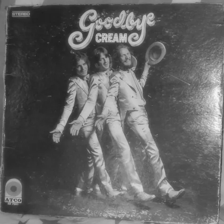

Distance from original: 0.47099175553440664


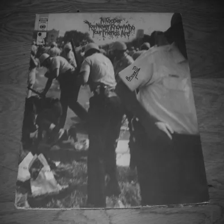

Distance from original: 0.4736766129069545


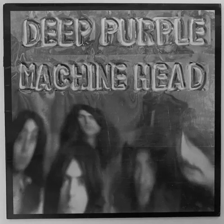

Distance from original: 0.4739162216071162


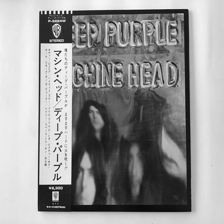

Distance from original: 0.4740195468266344


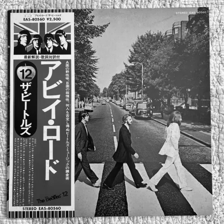

Distance from original: 0.4742468143253521


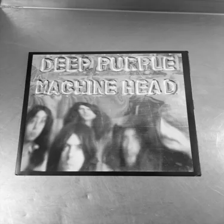

Distance from original: 0.474488390696577


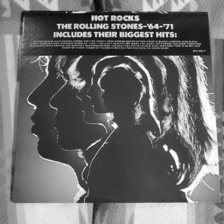

Distance from original: 0.47567027149826846


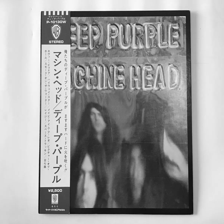

Distance from original: 0.47711995690989184


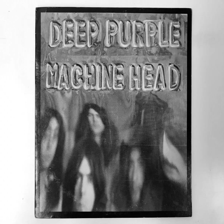

Distance from original: 0.4796009963919743


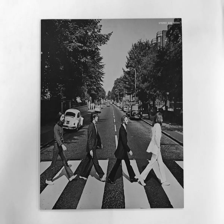

Distance from original: 0.48001470102794375


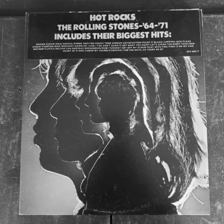

Distance from original: 0.4809253858340836


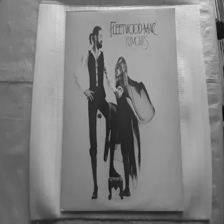

Distance from original: 0.4812850661871697


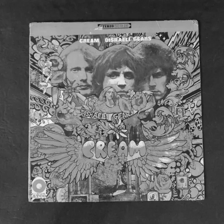

Distance from original: 0.4837539002478236


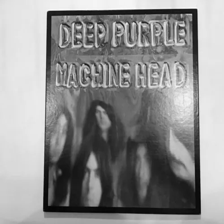

Distance from original: 0.48429621289774794


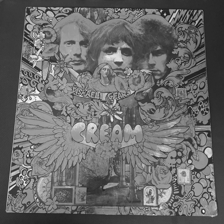

Distance from original: 0.4845369292310471


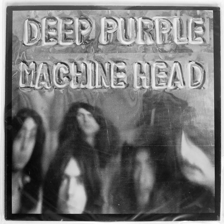

Distance from original: 0.485648536235756


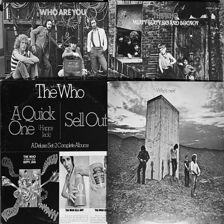

Distance from original: 0.4862864017415094


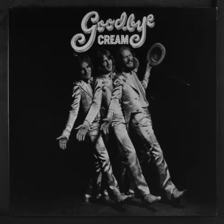

Distance from original: 0.48816873565516294


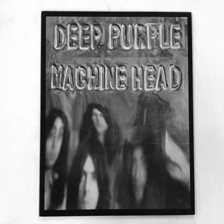

Distance from original: 0.4886937673045355


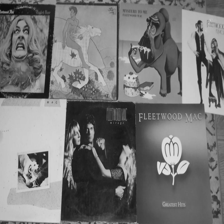

Distance from original: 0.48886016172461655


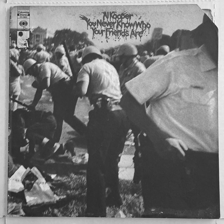

Distance from original: 0.4892670979828888


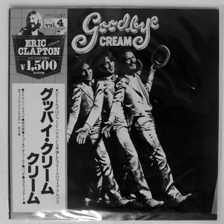

Distance from original: 0.4893199071915376


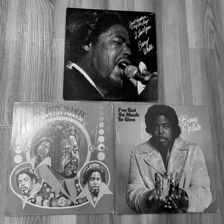

Distance from original: 0.4899281167520474


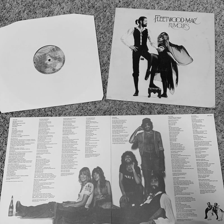

Distance from original: 0.4952829532378632


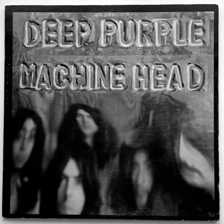

Distance from original: 0.49554237578526716


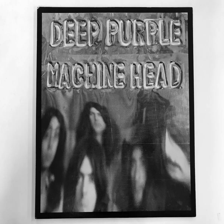

Distance from original: 0.49609691518326415


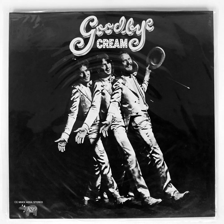

Distance from original: 0.4971218217701694


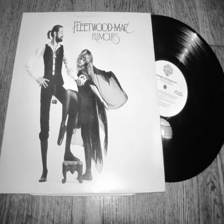

Distance from original: 0.49732318363261985


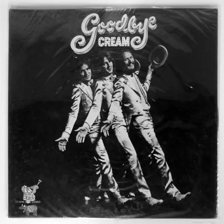

Distance from original: 0.4987437379383124


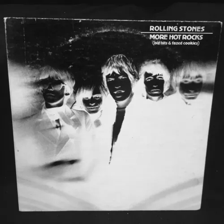

Distance from original: 0.49892929663140406


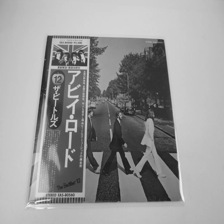

Distance from original: 0.4990283382511367


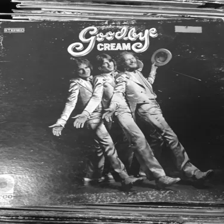

Distance from original: 0.4994987718975915


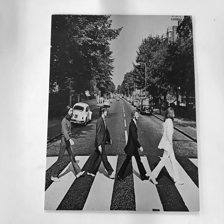

Distance from original: 0.499638164550572


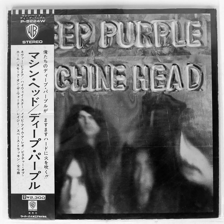

Distance from original: 0.5011705120924688


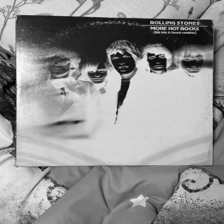

Distance from original: 0.502269259138252


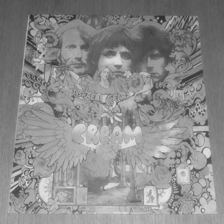

Distance from original: 0.502675647272018


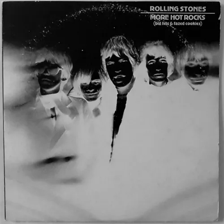

Distance from original: 0.5044172127616265


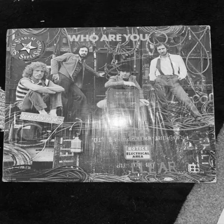

Distance from original: 0.5047255806661679


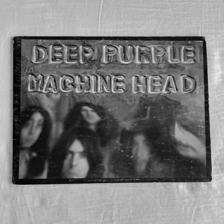

Distance from original: 0.5048176253358463


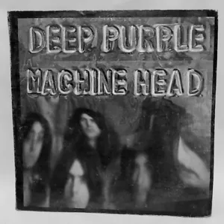

Distance from original: 0.5050512252194137


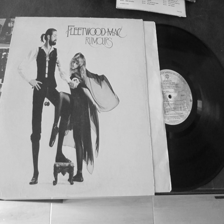

Distance from original: 0.5086635953914518


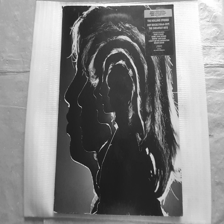

Distance from original: 0.5089787655145772


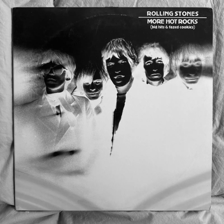

Distance from original: 0.510003042475172


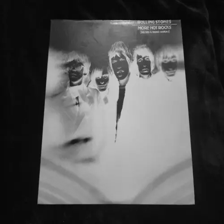

Distance from original: 0.5100932554016702


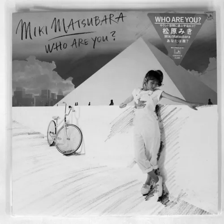

Distance from original: 0.5106683177797875


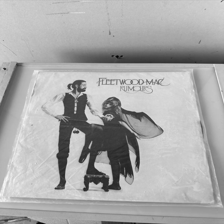

Distance from original: 0.5106825785675969


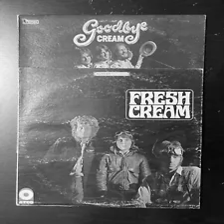

Distance from original: 0.5119355367781917


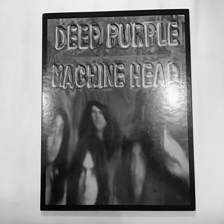

Distance from original: 0.5124060730058728


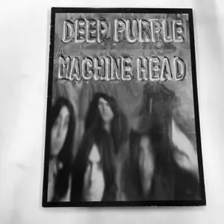

Distance from original: 0.5127038086206046


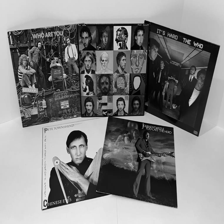

Distance from original: 0.5131663893238823


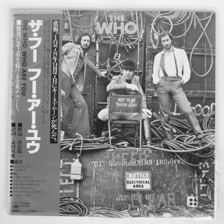

Distance from original: 0.5139417195557754


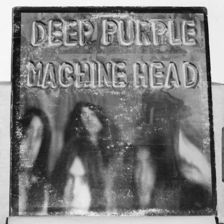

Distance from original: 0.5161072973616795


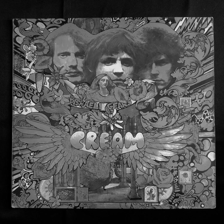

Distance from original: 0.5162846818719695


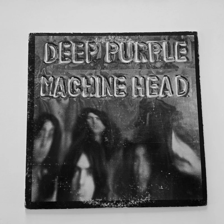

Distance from original: 0.516302962513981


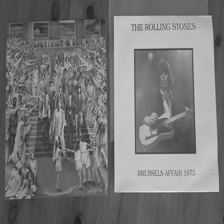

Distance from original: 0.5168057783931477


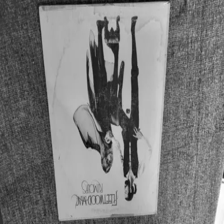

Distance from original: 0.5177861543348705


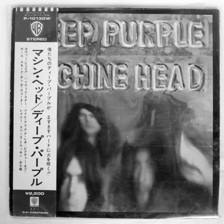

Distance from original: 0.5179192342381418


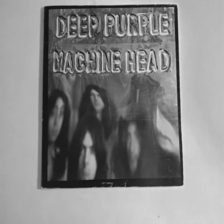

Distance from original: 0.5188135141743736


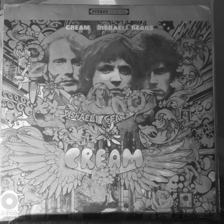

Distance from original: 0.520268613397761


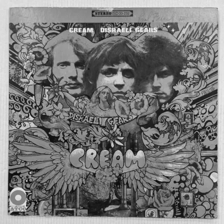

Distance from original: 0.5210300749189329


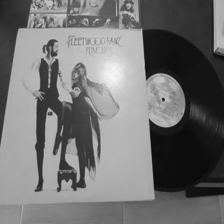

Distance from original: 0.5210391839719557


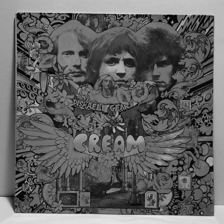

Distance from original: 0.52237699929035


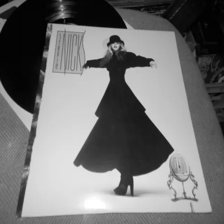

Distance from original: 0.5228559831651538


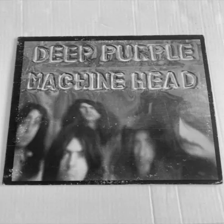

Distance from original: 0.5230515109994462


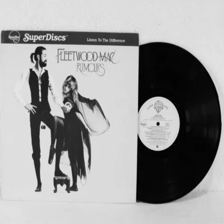

Distance from original: 0.5238855149014192


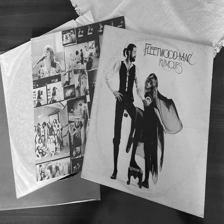

Distance from original: 0.5247955219831945


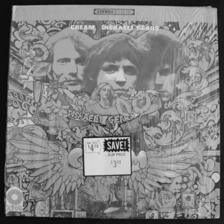

Distance from original: 0.5250903136519101


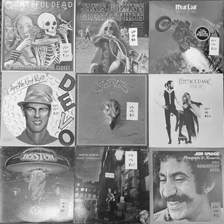

Distance from original: 0.5254753219955322


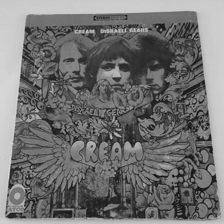

Distance from original: 0.5262847656556451


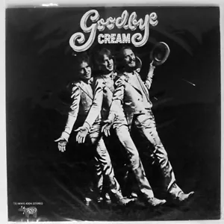

Distance from original: 0.5265136745873753


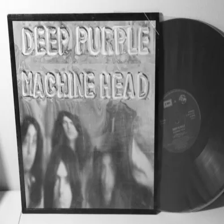

Distance from original: 0.526961036385256


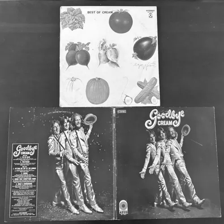

Distance from original: 0.5274016740300849


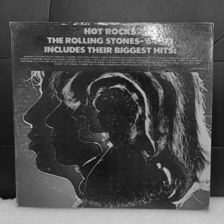

Distance from original: 0.5299393849755716


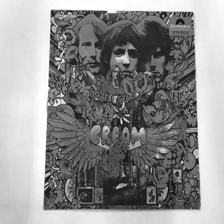

Distance from original: 0.5299847243122024


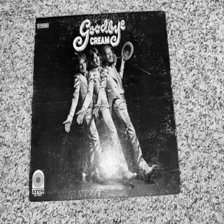

Distance from original: 0.5314081506897106


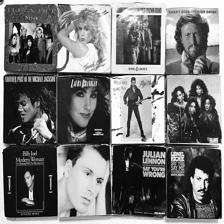

Distance from original: 0.5318428275273155


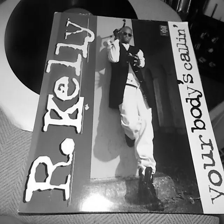

Distance from original: 0.5323058321537928


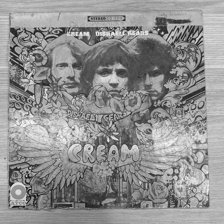

Distance from original: 0.533207075260441


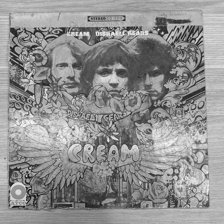

Distance from original: 0.533207075260441


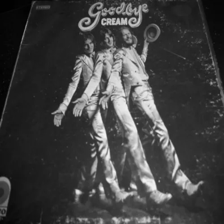

Distance from original: 0.5335908077253145


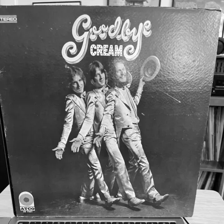

Distance from original: 0.5336944936204335


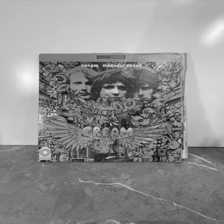

Distance from original: 0.5367646635684069


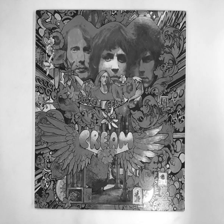

Distance from original: 0.5389905339585173


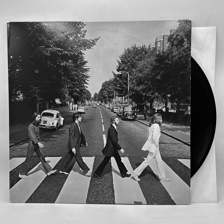

Distance from original: 0.5394465819416077


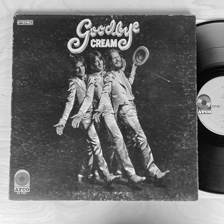

Distance from original: 0.540688973565552


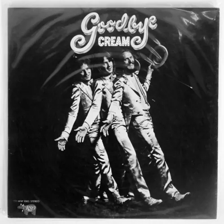

Distance from original: 0.5416343439530495


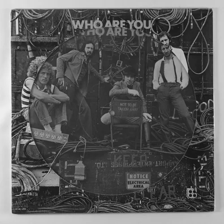

Distance from original: 0.5418609548596436


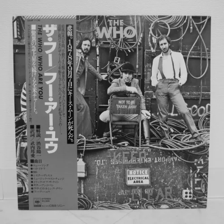

Distance from original: 0.5427672410801153


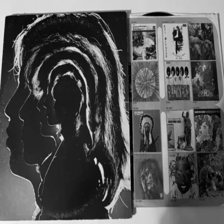

Distance from original: 0.5447398082417124


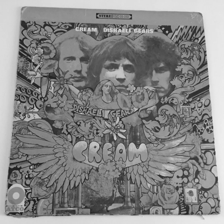

Distance from original: 0.5453050240237449


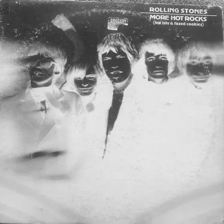

Distance from original: 0.5457148390252479


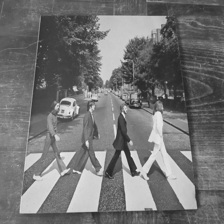

Distance from original: 0.5460223694226917


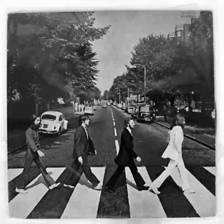

Distance from original: 0.5477818687533259


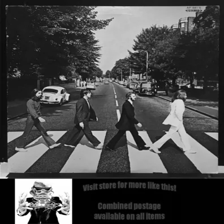

Distance from original: 0.5488059126595691


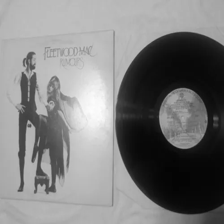

Distance from original: 0.5499415131731812


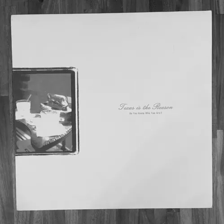

Distance from original: 0.5508982207275646


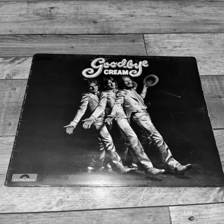

Distance from original: 0.5513409205420692


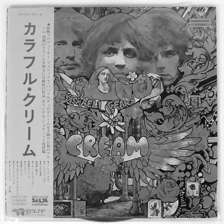

Distance from original: 0.5528798133092541


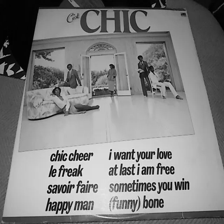

Distance from original: 0.5530528137306783


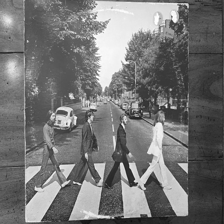

Distance from original: 0.5553828789405935


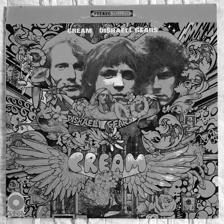

Distance from original: 0.5559250191644491


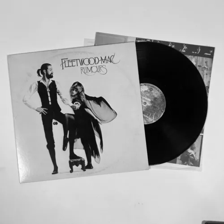

Distance from original: 0.5581809208173618


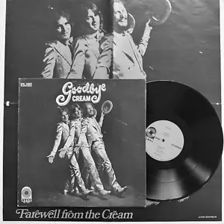

Distance from original: 0.5604306268988087


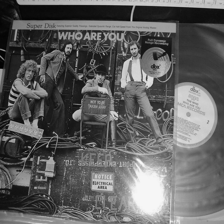

Distance from original: 0.5609695221771668


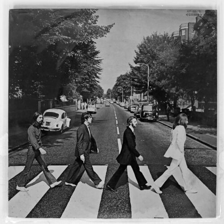

Distance from original: 0.5615875806260537


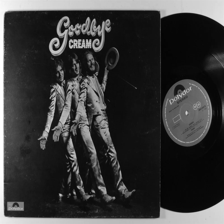

Distance from original: 0.5629980451552647


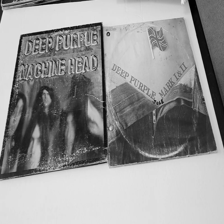

Distance from original: 0.5631973320008783


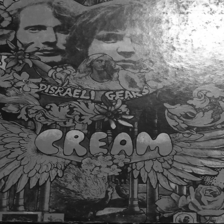

Distance from original: 0.5643120698846926


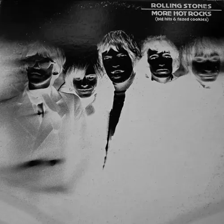

Distance from original: 0.5655110174497877


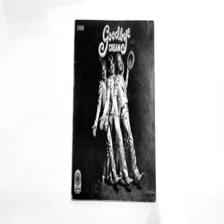

Distance from original: 0.5667555252565526


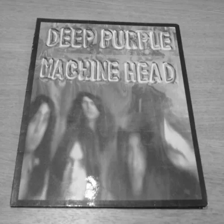

Distance from original: 0.5680626902517956


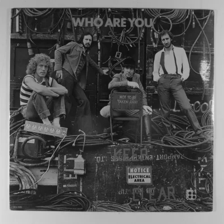

Distance from original: 0.5684456744130953


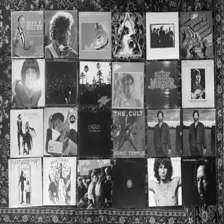

Distance from original: 0.568554660311277


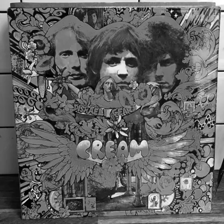

Distance from original: 0.568723036474281


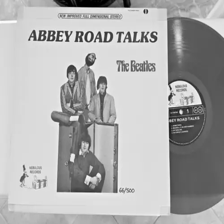

Distance from original: 0.5688221903067905


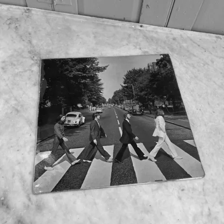

Distance from original: 0.5692814088780229


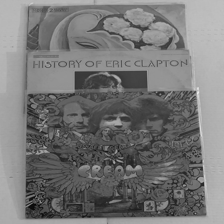

Distance from original: 0.5711713687454497


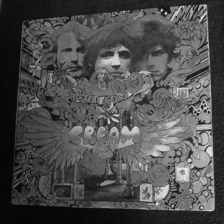

Distance from original: 0.5731942425564419


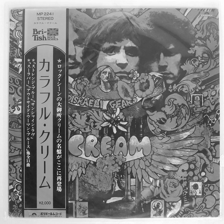

Distance from original: 0.5735090097484341


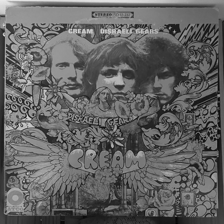

Distance from original: 0.5752431195214599


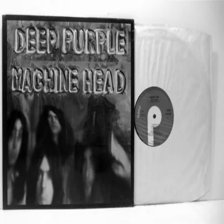

Distance from original: 0.5756598576912262


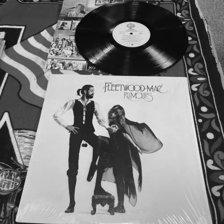

Distance from original: 0.5757181153739601


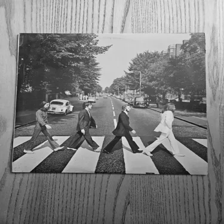

Distance from original: 0.5796911196999673


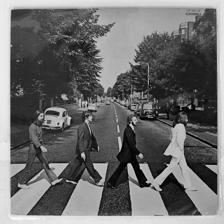

Distance from original: 0.5819765658531528


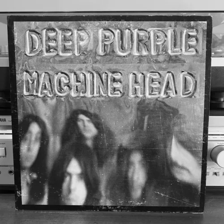

Distance from original: 0.5819829691535348


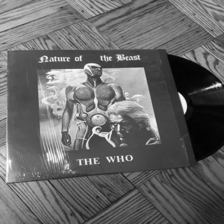

Distance from original: 0.5825031427981487


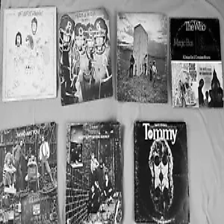

Distance from original: 0.5836595334849071


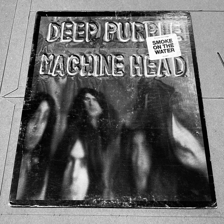

Distance from original: 0.5837428465180563


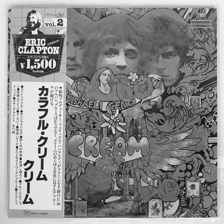

Distance from original: 0.5864779161641


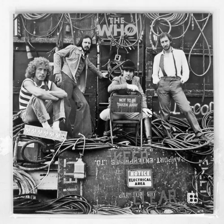

Distance from original: 0.5884099251903088


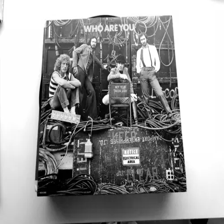

Distance from original: 0.5889579666078208


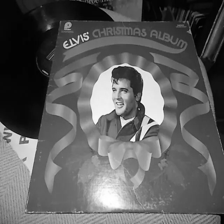

Distance from original: 0.5891204792887004


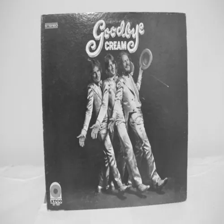

Distance from original: 0.5892674990085088


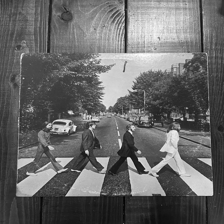

Distance from original: 0.5899581008632502


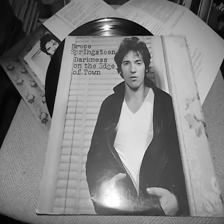

Distance from original: 0.5907796982834362


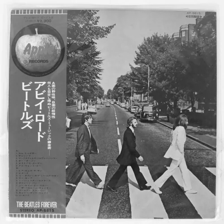

Distance from original: 0.59104854998454


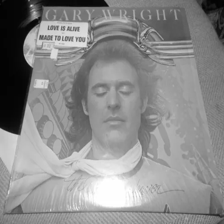

Distance from original: 0.5912365872234548


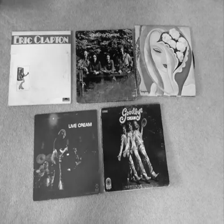

Distance from original: 0.5929203069370145


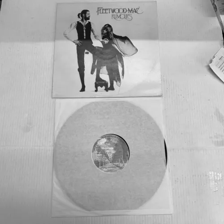

Distance from original: 0.5931630463221238


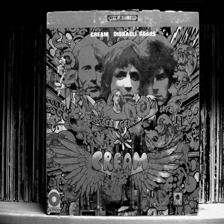

Distance from original: 0.594390488283506


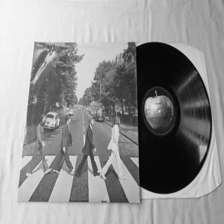

Distance from original: 0.5953704009275747


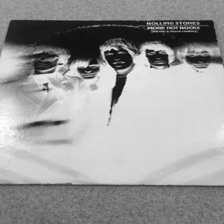

Distance from original: 0.5961374842366691


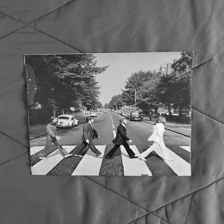

Distance from original: 0.5971261675596243


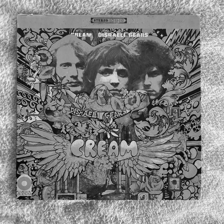

Distance from original: 0.6008832059706046


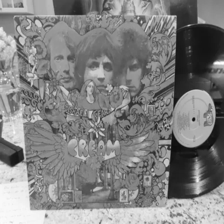

Distance from original: 0.6028836479623949


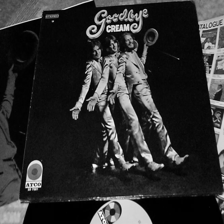

Distance from original: 0.6033192391835539


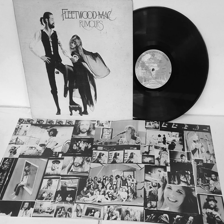

Distance from original: 0.6034394800764917


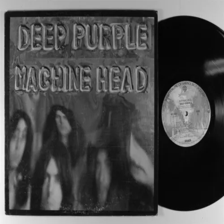

Distance from original: 0.603927948436696


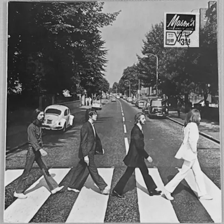

Distance from original: 0.6043348647071247


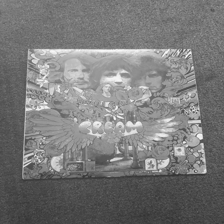

Distance from original: 0.6048965407118146


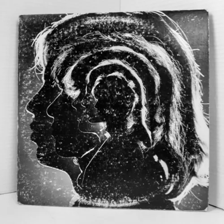

Distance from original: 0.6052740624414135


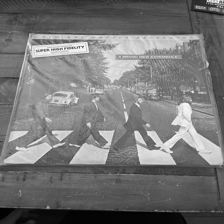

Distance from original: 0.6055659729435199


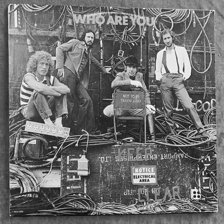

Distance from original: 0.6059497045170933


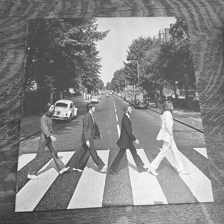

Distance from original: 0.6068290949526174


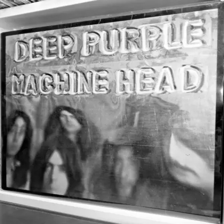

Distance from original: 0.6069692063160848


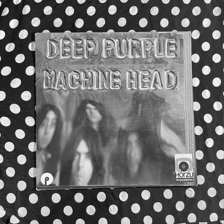

Distance from original: 0.6077740735743011


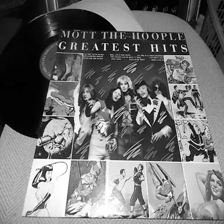

Distance from original: 0.6082583626224135


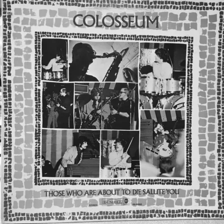

Distance from original: 0.608919452841155


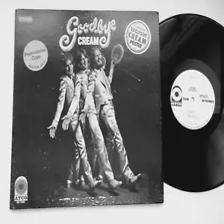

Distance from original: 0.6094091082016067


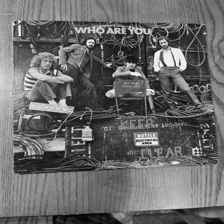

Distance from original: 0.6098710904392994


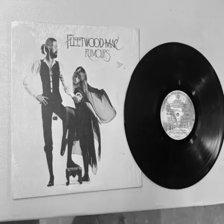

Distance from original: 0.6101364551799804


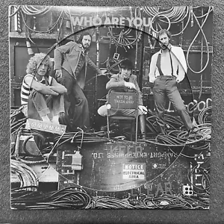

Distance from original: 0.6104514010469793


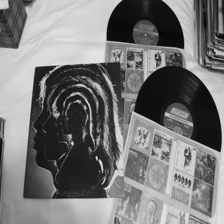

Distance from original: 0.6106671791452054


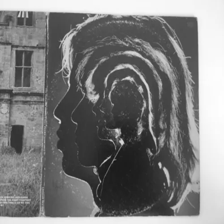

Distance from original: 0.6110309416666131


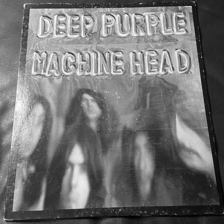

Distance from original: 0.6138360823804858


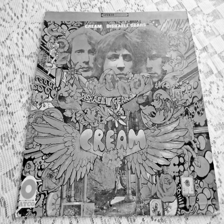

Distance from original: 0.6149284528202126


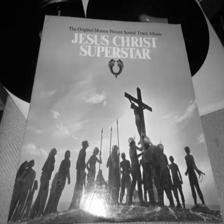

Distance from original: 0.6150710656019405


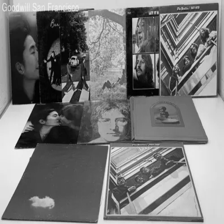

Distance from original: 0.6165976786469591


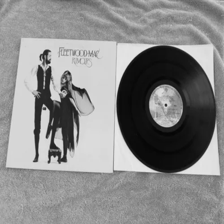

Distance from original: 0.6168923639771051


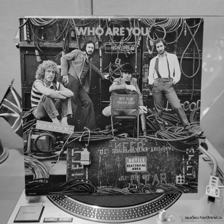

Distance from original: 0.6183213261832098


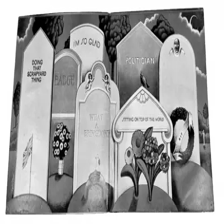

Distance from original: 0.6185349467781799


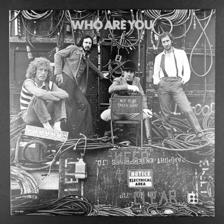

Distance from original: 0.6193534562509025


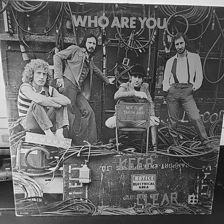

Distance from original: 0.6196346370239013


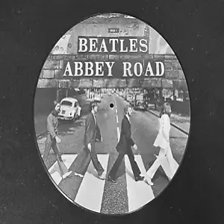

Distance from original: 0.6202289830066459


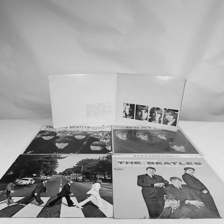

Distance from original: 0.6213577322258077


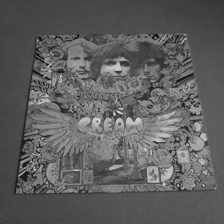

Distance from original: 0.6215837747200252


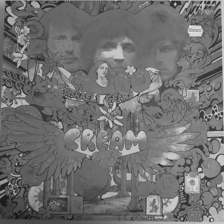

Distance from original: 0.6258473829255891


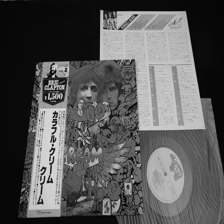

Distance from original: 0.6267839463314551


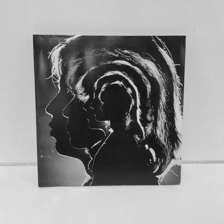

Distance from original: 0.6268286095113853


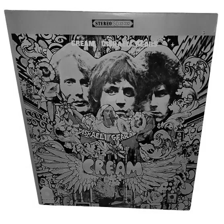

Distance from original: 0.6270240401365155


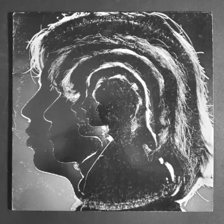

Distance from original: 0.6274926422542912


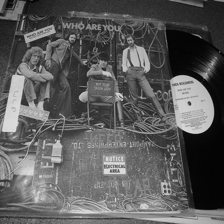

Distance from original: 0.6275428518124302


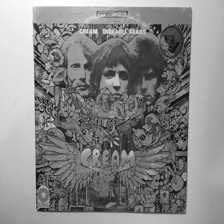

Distance from original: 0.6278773262099497


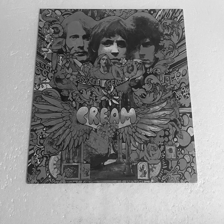

Distance from original: 0.628006989664907


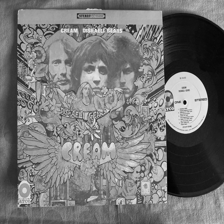

Distance from original: 0.629646170945957


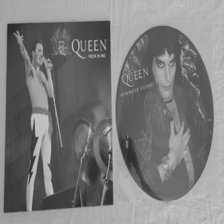

Distance from original: 0.6306014282388984


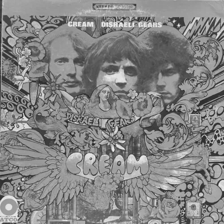

Distance from original: 0.6311185483650387


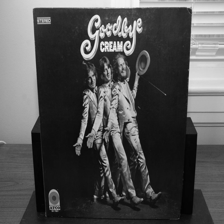

Distance from original: 0.6313392308125179


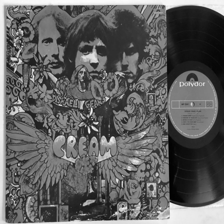

Distance from original: 0.6314862715369638


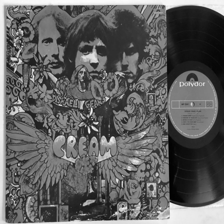

Distance from original: 0.6314862715369638


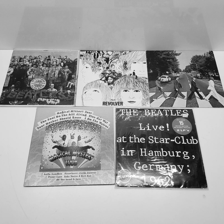

Distance from original: 0.6324108340765149


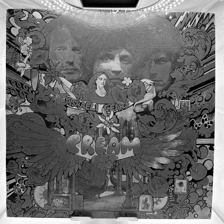

Distance from original: 0.6340668876778851


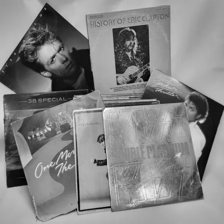

Distance from original: 0.6371102196208113


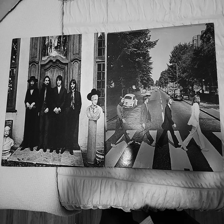

Distance from original: 0.6384629613210012


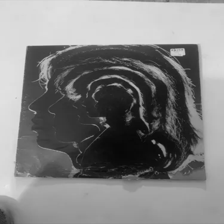

Distance from original: 0.6387985621887473


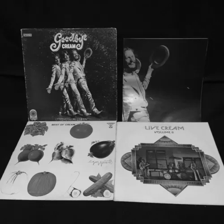

Distance from original: 0.6394481126152723


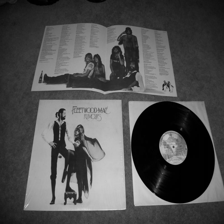

Distance from original: 0.6397616795909705


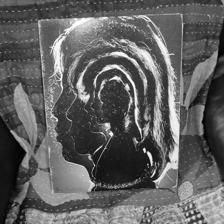

Distance from original: 0.6407587733376812


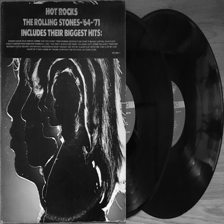

Distance from original: 0.6415536189265139


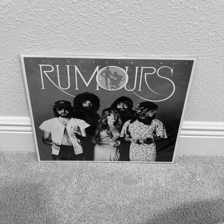

Distance from original: 0.6432294526567268


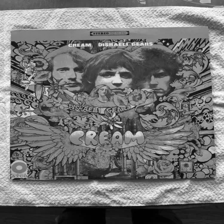

Distance from original: 0.6433323068929282


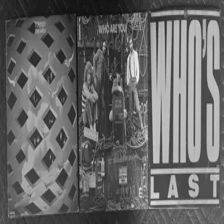

Distance from original: 0.6446044020112972


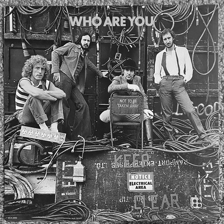

Distance from original: 0.6447513661837811


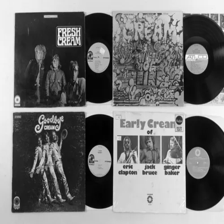

Distance from original: 0.6454213162964832


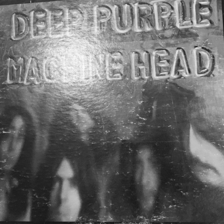

Distance from original: 0.6480218567534946


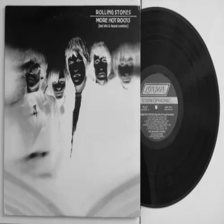

Distance from original: 0.649669501317959


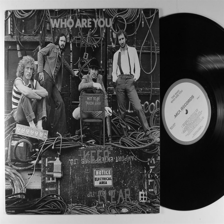

Distance from original: 0.6502422444793143


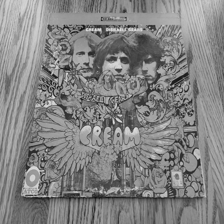

Distance from original: 0.6509004418353581


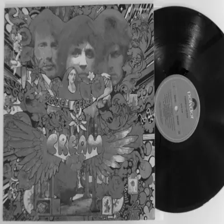

Distance from original: 0.6525515867674057


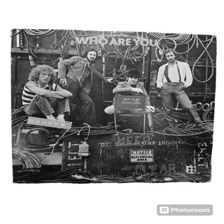

Distance from original: 0.6547387838834622


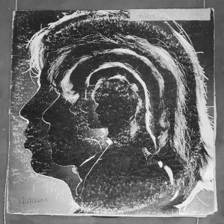

Distance from original: 0.6553065397611728


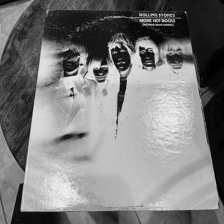

Distance from original: 0.6571445518851254


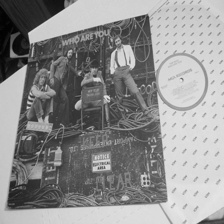

Distance from original: 0.6583001896296795


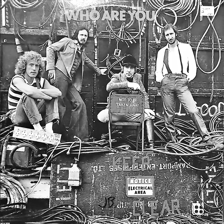

Distance from original: 0.6590802566982531


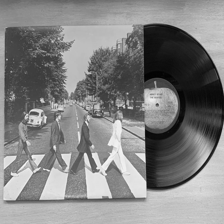

Distance from original: 0.659644654849501


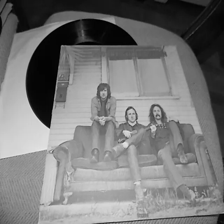

Distance from original: 0.659855620030821


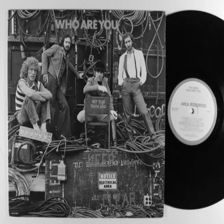

Distance from original: 0.6606922004510944


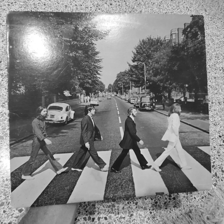

Distance from original: 0.6608128706078777


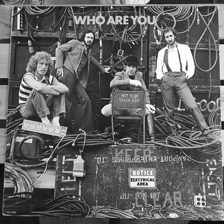

Distance from original: 0.6614276987483225


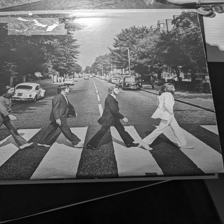

Distance from original: 0.6619782611434755


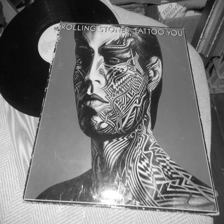

Distance from original: 0.6620094310580835


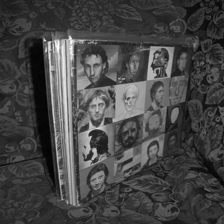

Distance from original: 0.662068516825268


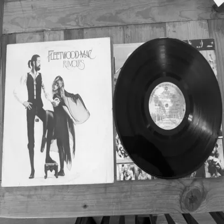

Distance from original: 0.6623068465109481


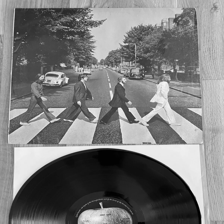

Distance from original: 0.6630625334135499


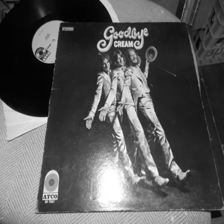

Distance from original: 0.6650710840410303


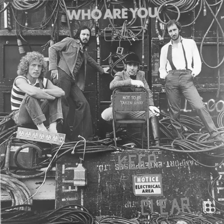

Distance from original: 0.6658277380858426


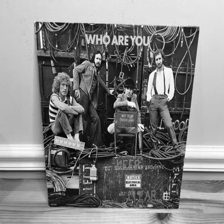

Distance from original: 0.6662611008685975


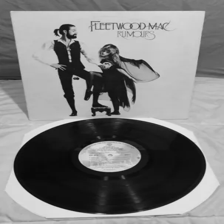

Distance from original: 0.6662913954371146


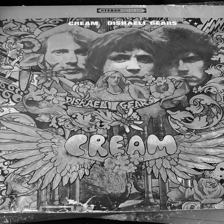

Distance from original: 0.6671448291294726


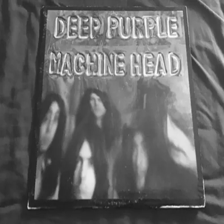

Distance from original: 0.667249501920973


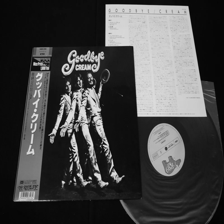

Distance from original: 0.6675255206311829


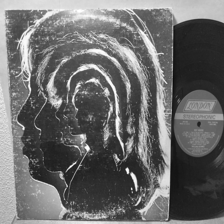

Distance from original: 0.6676964727711081


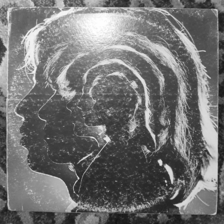

Distance from original: 0.6681913994310862


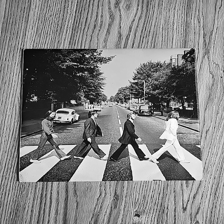

Distance from original: 0.6685492989433559


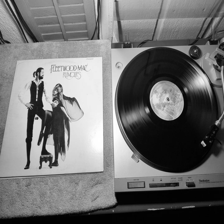

Distance from original: 0.6694801629749952


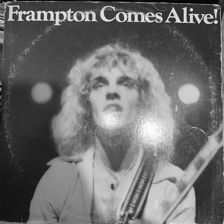

Distance from original: 0.6697094865725052


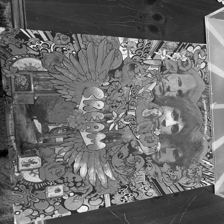

Distance from original: 0.6700553017891911


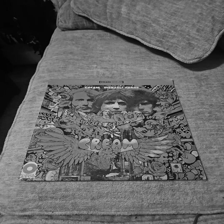

Distance from original: 0.671088996330804


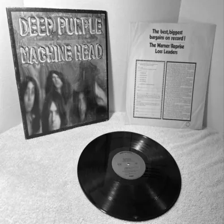

Distance from original: 0.6723718105421254


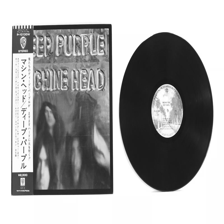

Distance from original: 0.6727339197297935


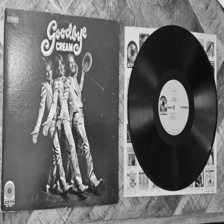

Distance from original: 0.6728334488849345


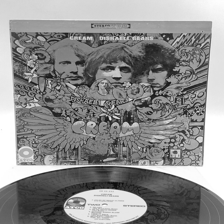

Distance from original: 0.6730338315840554


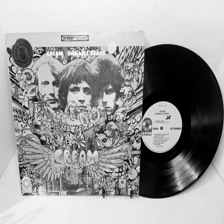

Distance from original: 0.6735849912817893


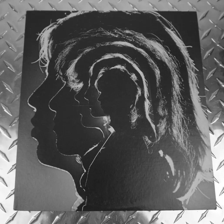

Distance from original: 0.6752638197492862


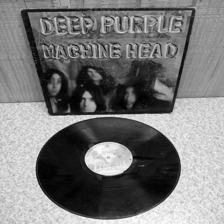

Distance from original: 0.676679919243558


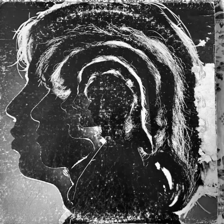

Distance from original: 0.677696495785781


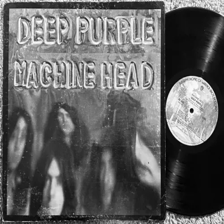

Distance from original: 0.6794820780307192


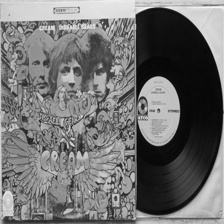

Distance from original: 0.6796129773193913


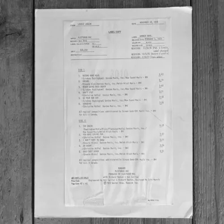

Distance from original: 0.6797291304923987


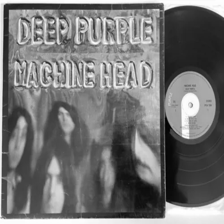

Distance from original: 0.6801248595001581


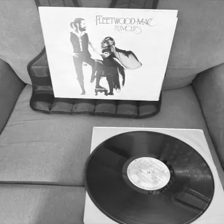

Distance from original: 0.6811310151914374


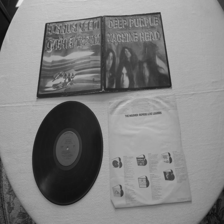

Distance from original: 0.6815456684541574


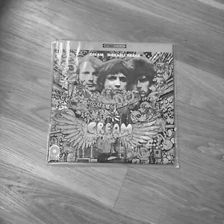

Distance from original: 0.6818138385795305


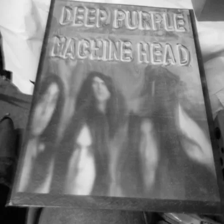

Distance from original: 0.6826189501129569


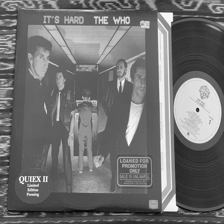

Distance from original: 0.6837297103963362


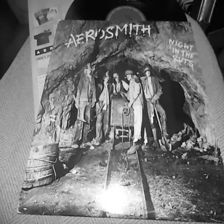

Distance from original: 0.6838827932718892


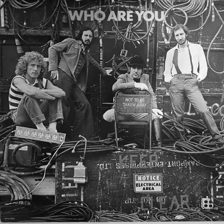

Distance from original: 0.6857693176416573


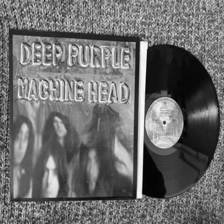

Distance from original: 0.6869132083551215


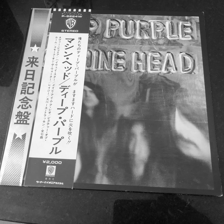

Distance from original: 0.6872902882669858


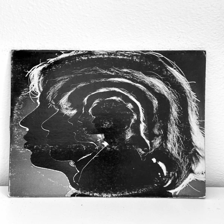

Distance from original: 0.6880481702762156


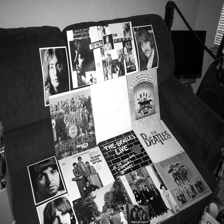

Distance from original: 0.6880887678554571


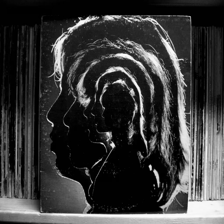

Distance from original: 0.689834695104282


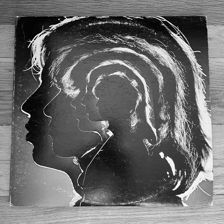

Distance from original: 0.6918141052874294


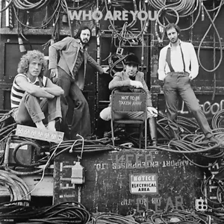

Distance from original: 0.6928279152839809


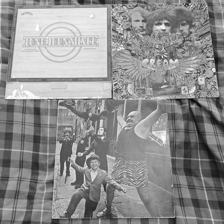

Distance from original: 0.6929697206086839


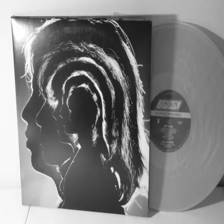

Distance from original: 0.6943076372171486


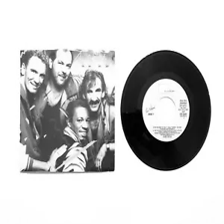

Distance from original: 0.6948833590312606


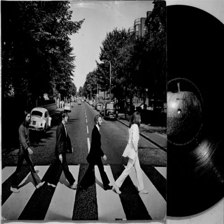

Distance from original: 0.6956088825689357


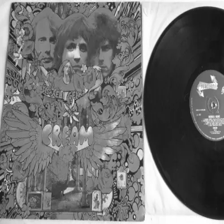

Distance from original: 0.6965125732678112


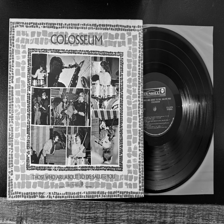

Distance from original: 0.6967350348618544


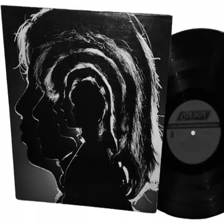

Distance from original: 0.698096783893326


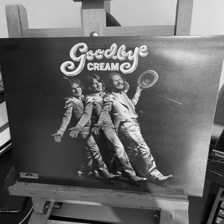

Distance from original: 0.6993876423106983


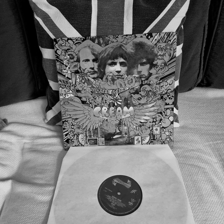

Distance from original: 0.7000034856566619


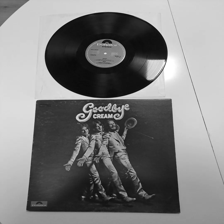

Distance from original: 0.7045090171009238


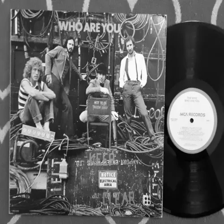

Distance from original: 0.7066353736953472


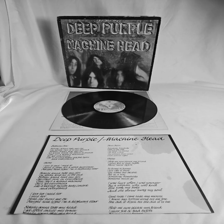

Distance from original: 0.7079948249757804


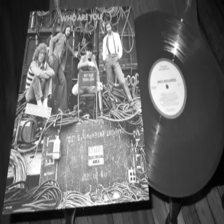

Distance from original: 0.7109992987782761


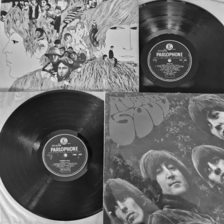

Distance from original: 0.7123446993597035


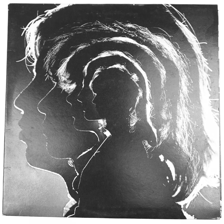

Distance from original: 0.7131904215393883


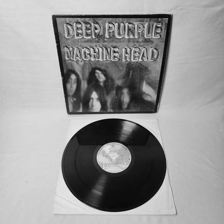

Distance from original: 0.716113574176102


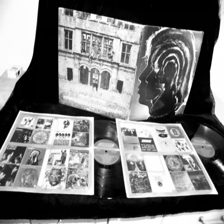

Distance from original: 0.7166721216053024


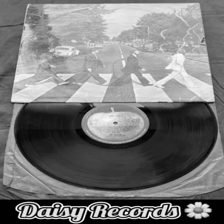

Distance from original: 0.7177101189895099


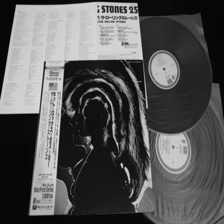

Distance from original: 0.7183307884916088


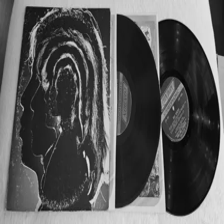

Distance from original: 0.7188294525131383


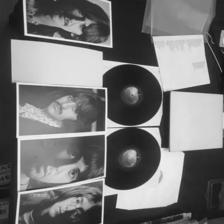

Distance from original: 0.7195050746899126


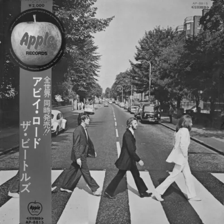

Distance from original: 0.7198123235917979


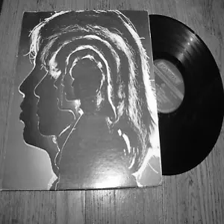

Distance from original: 0.721295879413832


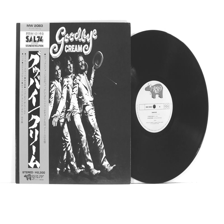

Distance from original: 0.7217059352032034


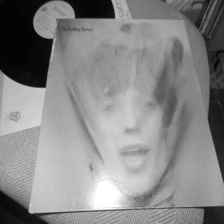

Distance from original: 0.7243801448171099


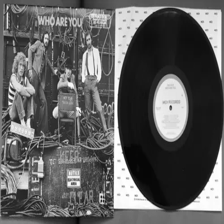

Distance from original: 0.7248194486724575


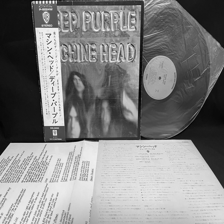

Distance from original: 0.72731629140369


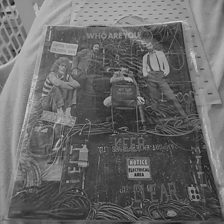

Distance from original: 0.7332276976368215


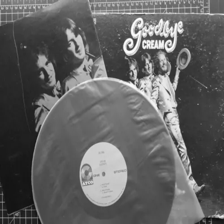

Distance from original: 0.7344768369004964


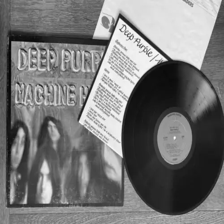

Distance from original: 0.7361120368075965


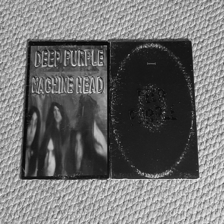

Distance from original: 0.7371975837769702


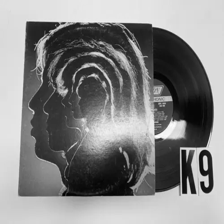

Distance from original: 0.7408686877467259


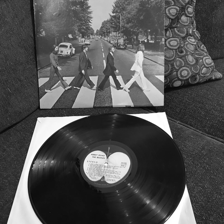

Distance from original: 0.7415587593962796


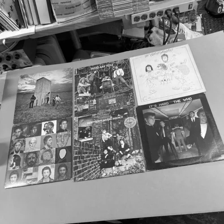

Distance from original: 0.7420498538060369


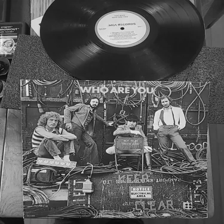

Distance from original: 0.743691190016705


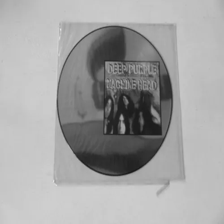

Distance from original: 0.7446941195653802


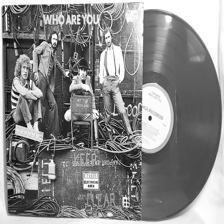

Distance from original: 0.7452518035754665


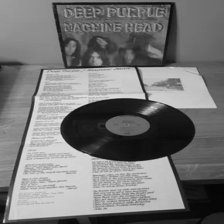

Distance from original: 0.7452530601533196


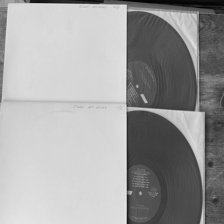

Distance from original: 0.7511278194850906


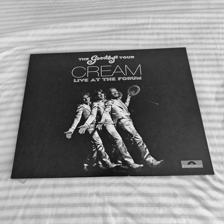

Distance from original: 0.7519910244563479


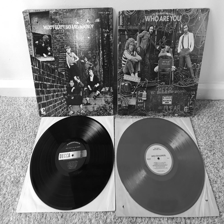

Distance from original: 0.7551062192600055


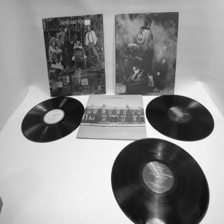

Distance from original: 0.7586115937289154


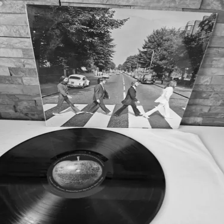

Distance from original: 0.7629792747250936


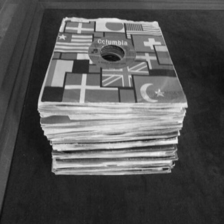

Distance from original: 0.7631995752227724


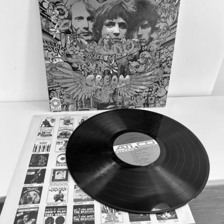

Distance from original: 0.7646490379370932


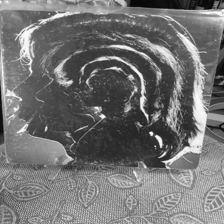

Distance from original: 0.7670466177919204


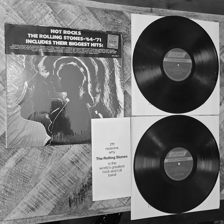

Distance from original: 0.768103871009963


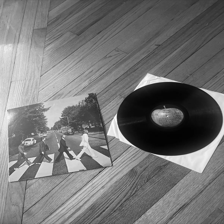

Distance from original: 0.7708243137661337


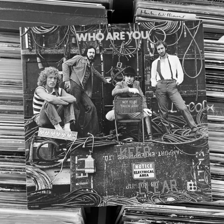

Distance from original: 0.7712524060687983


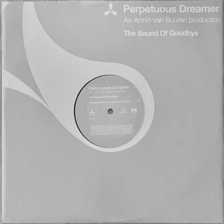

Distance from original: 0.7715593946106643


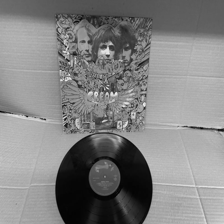

Distance from original: 0.7731460616015009


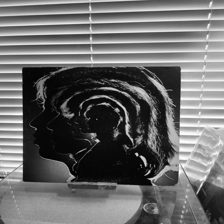

Distance from original: 0.7732354220610336


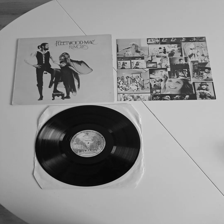

Distance from original: 0.7751104091882234


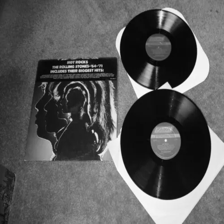

Distance from original: 0.7751649294774976


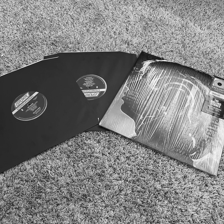

Distance from original: 0.775239520724796


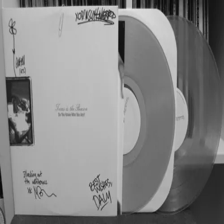

Distance from original: 0.7775321300162741


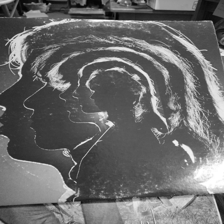

Distance from original: 0.7787187516453766


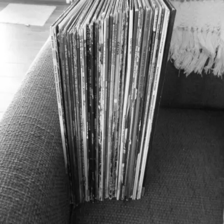

Distance from original: 0.7791682007600929


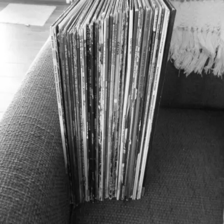

Distance from original: 0.7791682007600929


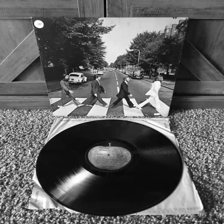

Distance from original: 0.7842258461068425


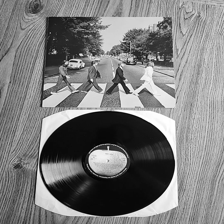

Distance from original: 0.7846343528102353


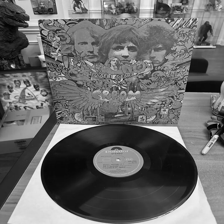

Distance from original: 0.786815876414753


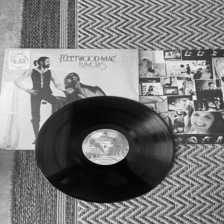

Distance from original: 0.7892358473603368


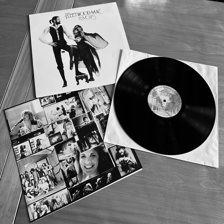

Distance from original: 0.7905173742228178


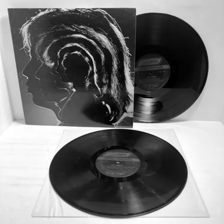

Distance from original: 0.7962562433193949


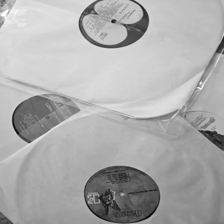

Distance from original: 0.7980477783959928


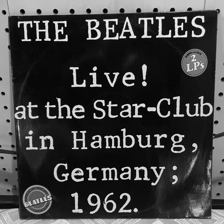

Distance from original: 0.8007172866527679


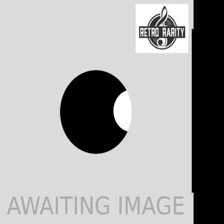

Distance from original: 0.8030363041321297


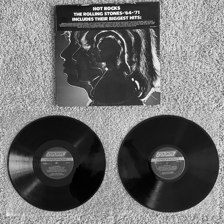

Distance from original: 0.8063121423540494


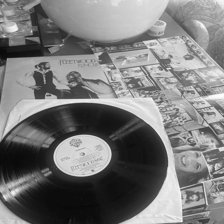

Distance from original: 0.82283066270685


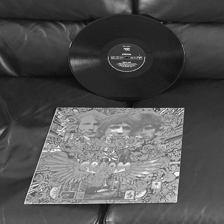

Distance from original: 0.8342047979093885


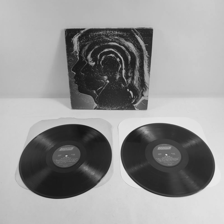

Distance from original: 0.840269947788211


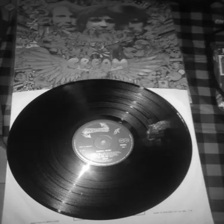

Distance from original: 0.8658138541158746


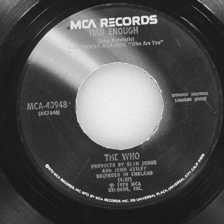

Distance from original: 0.8781828831999047


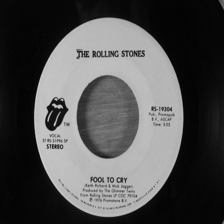

Distance from original: 0.8798293868306294


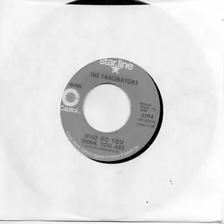

Distance from original: 0.8869102628236794


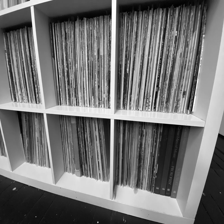

Distance from original: 0.8903302084109143


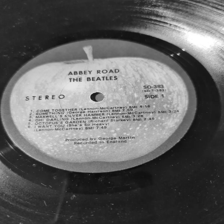

Distance from original: 0.8940408935430092


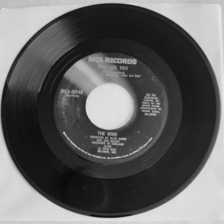

Distance from original: 0.9011728390539953


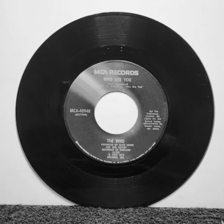

Distance from original: 0.9238634579493546


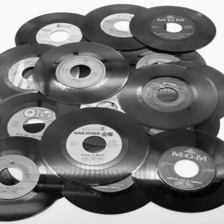

Distance from original: 0.926166623660118


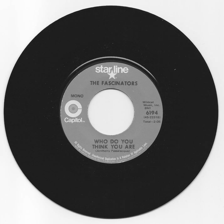

Distance from original: 0.9446456798138851


In [22]:
# display a list of top x most similar images/items with price etc:
print('Your items value based on',len(sorted_distances), 'comparable items sold is:')
print('')
print('--$',df['sold'].mean(),'--')
print('')
print('-> Min Price sold: $',df['sold'].min())
print('-> Max Price sold: $',df['sold'].max())
print(' ')
print('Details -> Top ', len(sorted_distances), ' most similar items found:')
print('')
i = 0
for image, distance in sorted_distances:
    file = Image.open('scraping/files/' + image).convert('L').resize(IMAGE_SHAPE)
    display(file)
    print('Distance from original:', distance)
#would be awesome to get a historic value of item (over past year at 1 month increments?)
#factor in other things like location, condition -> see records VG VG+ etc

In [ ]:
# seem to have an issue with image similarity that was previously working 
#maybe need to use object detection/extraction or add ocr before final hand in

## Use Multiple Linear Regression Model on Similar images to Predict Price

In [ ]:
#